In [ ]:
!pip3 install tensorflow==2.8
!pip3 install lime
!pip3 install shap==0.40.0
!pip3 install -q tfimm
!pip3 install -q timm==0.6.13
!pip3 install tensorflow-addons
!pip3 install numba

In [ ]:
from numba import cuda

device = cuda.get_current_device()
device.reset()

In [1]:
import sys, os, glob, pathlib, shap, warnings, tfimm, shutil, time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from lime import lime_image
from skimage.segmentation import mark_boundaries
from skimage.io import imread, imsave
from skimage.util import crop
from skimage.transform import resize

from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, matthews_corrcoef, roc_auc_score

warnings.filterwarnings(action="ignore", message="^internal gelsd")

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers, Model, Input
from tensorflow.keras.preprocessing import image_dataset_from_directory, image
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy, KLDivergence
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.data.experimental import cardinality

from tensorflow_addons.optimizers import AdamW

from google.colab import drive
drive.mount('/content/drive')

sys.path.insert(0,'/content/drive/MyDrive/tese_mestrado_JoseMauricio_ISEC/utils')
from gradCam import read_and_transform_img, make_gradcam_heatmap_ViT, display_gradcam
from distillation_ViT import DeiT, ViTDistilled
from distillation import Distiller
from student_vit import StudentViT
from occlusion_maps import OcclusionMaps
from rise import RISE



TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.10.0 and strictly below 2.13.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.8.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/a

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<h1>Load Dataset</h1>

In [ ]:
!unzip -q '/content/drive/MyDrive/tese_mestrado_JoseMauricio_ISEC/datasets/dataset_CD_UC_v4.zip'

In [ ]:
for url in glob.glob('/content/dataset_CD_UC/ulcerative-colitis-crop/*.jpg'):
  img = imread(url)
  crop_img = crop(img, ((0, 179), (25, 0), (0,0)), copy=False)
  imsave('/content/dataset_CD_UC/ulcerative-colitis/'+url.split('/')[4], crop_img)

In [ ]:
os.mkdir('/content/frames/frames_train')
os.mkdir('/content/frames/frames_test')

os.mkdir('/content/frames/frames_train/crohn-disease')
os.mkdir('/content/frames/frames_train/ulcerative-colitis')

os.mkdir('/content/frames/frames_test/crohn-disease')
os.mkdir('/content/frames/frames_test/ulcerative-colitis')

In [ ]:
for url in glob.glob('/content/frames-crop/*.jpg'):
  img = imread(url)
  crop_img = crop(img, ((0, 179), (25, 0), (0,0)), copy=False)
  imsave('/content/frames/frames_test/ulcerative-colitis/'+url.split('/')[3], crop_img)

list_files = [name for name in glob.glob('/content/frames/ulcerative-colitis/*.jpg')]
for a in list_files:
  shutil.move(a, '/content/frames/frames_train/ulcerative-colitis/')

In [ ]:
os.rmdir(pathlib.Path('/content/frames/ulcerative-colitis'))
!rm -r '/content/dataset_CD_UC/ulcerative-colitis-crop/'
!rm -r '/content/frames-crop/'

In [2]:
data_dir = pathlib.Path('/content/dataset_CD_UC')
data_dir_frames_train = pathlib.Path('/content/frames/frames_train')
data_dir_frames_test = pathlib.Path('/content/frames/frames_test')

# Input size initial
batch_size = 32
IMG_SIZE = (224, 224)

# Distillation
BASE_LR = 1e-5
WEIGHT_DECAY = 0.0001
lr_scaled = (BASE_LR / 512) * batch_size

train_ds = image_dataset_from_directory(
  data_dir,
  validation_split=0.7,
  subset="training",
  seed=123,
  shuffle=True,
  image_size=IMG_SIZE,
  batch_size=batch_size)

val_ds = image_dataset_from_directory(
  data_dir,
  validation_split=0.3,
  subset="validation",
  seed=123,
  shuffle=True,
  image_size=IMG_SIZE,
  batch_size=batch_size)

val_batches = cardinality(val_ds)
test_ds = val_ds.take((2*val_batches) // 3)    #Take 20% for test
val_ds = val_ds.skip((2*val_batches) // 3)   #Take 10% for validation

class_names = train_ds.class_names

print(class_names)

Found 2205 files belonging to 2 classes.
Using 662 files for training.
Found 2205 files belonging to 2 classes.
Using 661 files for validation.
['crohn-disease', 'ulcerative-colitis']


In [3]:
frames_train = image_dataset_from_directory(data_dir_frames_train,image_size=IMG_SIZE,batch_size=batch_size)
frames_test = image_dataset_from_directory(data_dir_frames_test,image_size=IMG_SIZE,batch_size=batch_size)

train_ds = train_ds.concatenate(frames_train)
test_ds = test_ds.concatenate(frames_test)

Found 34 files belonging to 2 classes.
Found 30 files belonging to 2 classes.


Found 2205 files belonging to 2 classes.


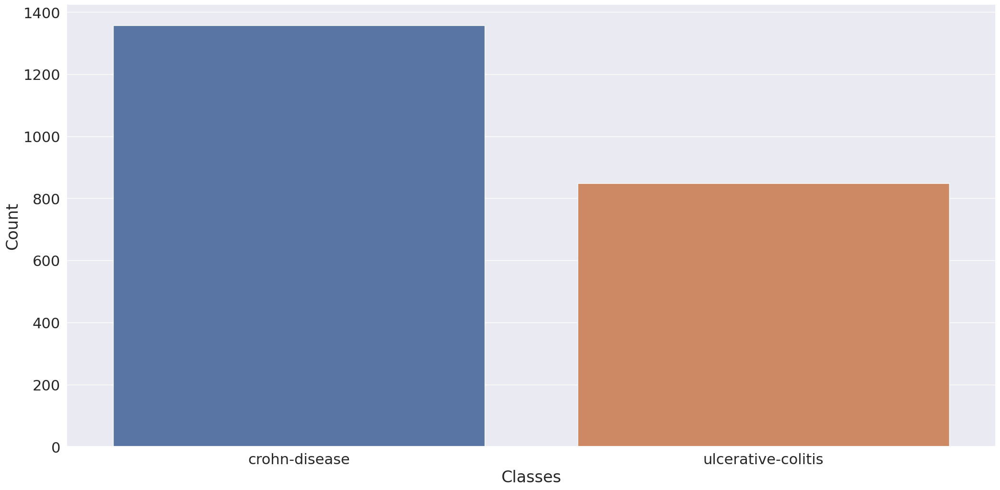

In [ ]:
def class_distribution(dataset):
    class_values = []
    total_batches = dataset.__len__().numpy()
    for batch, element in enumerate(dataset.as_numpy_iterator()):
        if batch+1 == total_batches:
            for i in range(len(element[1])):
                class_values.append(class_names[int(element[1][i])])
        else:
            for i in range(batch_size):
                class_values.append(class_names[int(element[1][i])])

    class_n, frequency = np.unique(np.array(class_values), return_counts=True)
    count = pd.DataFrame(columns=["Classes","Count"])
    count["Classes"] = class_n
    count["Count"] = frequency
    return count, class_values

dataset1 = image_dataset_from_directory(data_dir)

df_class_dist, class_df_values_val = class_distribution(dataset1)
plt.figure(figsize=(25, 12))
sns.set(font_scale=2.0)
sns.barplot(data=df_class_dist, y="Count" ,x="Classes");
plt.show()

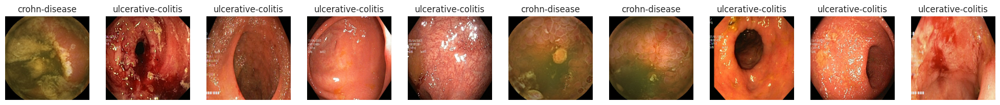

In [ ]:
plt.figure(figsize=(25, 15))
for images, labels in train_ds.take(1):
    for i in range(10):
        ax = plt.subplot(2, 10, i + 1)
        sns.set(font_scale=1.0)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(class_names[labels[i]])
        plt.axis("off")

<h1>Classificiation</h1>

In [4]:
data_augmentation = Sequential([
  layers.RandomFlip("horizontal_and_vertical"),
  layers.RandomRotation(0.2),
  layers.RandomContrast(0.15),
  layers.RandomZoom(-.2,-.3)
])

In [5]:
early_stopping = EarlyStopping(monitor='val_accuracy', patience=5)
sns.set(font_scale=1.0)

In [6]:
images, labels = tuple(zip(*val_ds))

true_images = np.concatenate(images)
true_labels = np.concatenate(labels)

<h1>Student model</h1>

In [7]:
inputs = Input(shape=IMG_SIZE+(3,))
outputs = ViTDistilled().call(inputs)
student_model_1 = Model(inputs, outputs)

student_model_1.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 tf.compat.v1.shape (TFOpLambda  (4,)                0           ['input_1[0][0]']                
 )                                                                                                
                                                                                                  
 tf.__operators__.getitem (Slic  ()                  0           ['tf.compat.v1.shape[0][0]']     
 ingOpLambda)                                                                                 

In [8]:
inputs = Input(shape=IMG_SIZE+(3,))
x = data_augmentation(inputs)
x = layers.Rescaling(1./255)(x)
outputs = StudentViT(16).call(x)
student_model_2 = Model(inputs, outputs)

student_model_2.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_6[0][0]']                
                                                                                                  
 rescaling (Rescaling)          (None, 224, 224, 3)  0           ['sequential[0][0]']             
                                                                                                  
 patches (Patches)              (None, None, 768)    0           ['rescaling[0][0]']        

<h1>Images to Interpretability</h1>

In [ ]:
for url in glob.glob('/content/test/ulcerative-colitis-crop/*.jpg'):
  img = imread(url)
  crop_img = crop(img, ((0, 179), (25, 0), (0,0)), copy=False)
  imsave('/content/test/ulcerative-colitis/'+url.split('/')[4], crop_img)

In [ ]:
!rm -r '/content/test/ulcerative-colitis-crop/'

In [9]:
dir = pathlib.Path('/content/test')
interpretability_data = image_dataset_from_directory(dir, image_size=IMG_SIZE, batch_size=batch_size)
print(interpretability_data.class_names)

images_exp, labels_exp = tuple(zip(*interpretability_data))

image_interpretability_4 = np.concatenate(images_exp)
labels_interpretability_4 = np.concatenate(labels_exp)

Found 6 files belonging to 2 classes.
['crohn-disease', 'ulcerative-colitis']


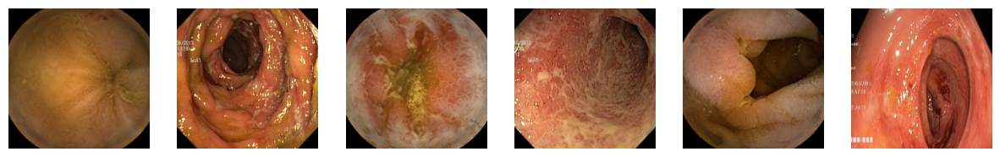

In [10]:
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  ax.imshow(img_array[0].astype(np.uint8))
  ax.axis('off')

In [11]:
print('*** Ground truth ***\n')
for val in labels_interpretability_4:
  if val == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

*** Ground truth ***

crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis


# ViT_B/32

In [ ]:
vit_model = tfimm.create_model("vit_base_patch32_224_in21k", pretrained=True, nb_classes=0)
vit_model_preprocessing = tfimm.create_preprocessing("vit_base_patch32_224_in21k")

inputs = Input(shape=(224, 224,3))
x = data_augmentation(inputs)
x = vit_model_preprocessing(x)
x = vit_model.call(x)
outputs = layers.Dense(len(class_names))(x)
model_vit_b32 = Model(inputs, outputs)

In [ ]:
model_vit_b32.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_b32.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history = model_vit_b32.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 24s 487ms/step - loss: 0.4493 - accuracy: 0.8491 - val_loss: 0.0751 - val_accuracy: 0.9770
Epoch 2/200
23/23 [==============================] - 9s 399ms/step - loss: 0.0163 - accuracy: 0.9957 - val_loss: 0.0041 - val_accuracy: 1.0000
Epoch 3/200
23/23 [==============================] - 10s 406ms/step - loss: 0.0057 - accuracy: 0.9986 - val_loss: 0.0053 - val_accuracy: 0.9979
Epoch 4/200
23/23 [==============================] - 10s 407ms/step - loss: 0.0035 - accuracy: 0.9986 - val_loss: 0.0021 - val_accuracy: 1.0000
Epoch 5/200
23/23 [==============================] - 10s 411ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 0.0029 - val_accuracy: 1.0000
Epoch 6/200
23/23 [==============================] - 10s 420ms/step - loss: 0.0013 - accuracy: 1.0000 - val_loss: 0.0028 - val_accuracy: 1.0000
Epoch 7/200
23/23 [==============================] - 10s 434ms/step - loss: 0.0029 - accuracy: 0.9986 - val_loss: 0.0020 - val_accuracy: 

<Axes: >

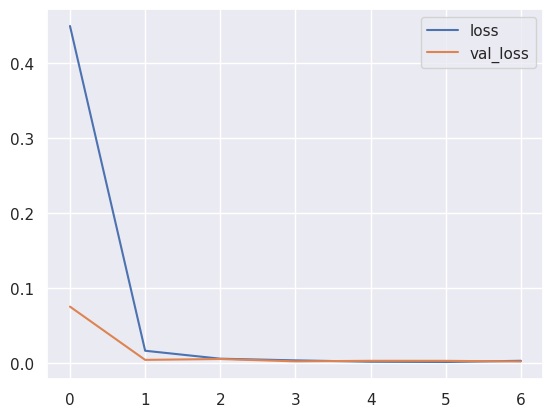

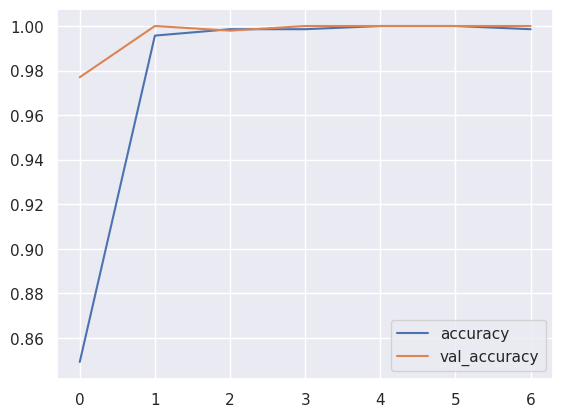

In [ ]:
model_history = pd.DataFrame(history.history)
model_history.loc[:, ['loss', 'val_loss']].plot()
model_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
start = time.time()
predict_labels_ = model_vit_b32.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels = np.argmax(model_vit_b32.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels)))

Accuracy: 1.0000
Loss: 0.0011
Inference Time: 3.07s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


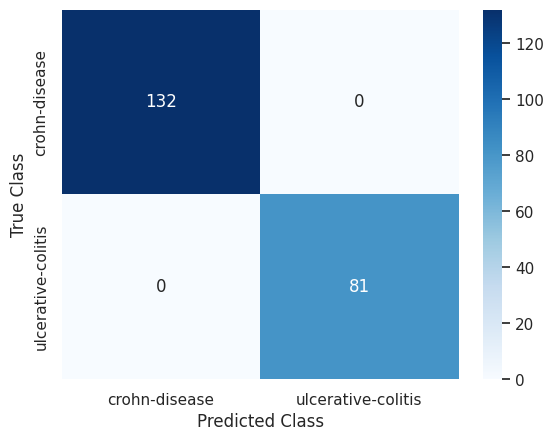

In [ ]:
conf_matrix = pd.DataFrame(confusion_matrix(true_labels, predict_labels), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_b32.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
ulcerative-colitis


<h2>Knowledge Distillation</h2>

In [ ]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_b32)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, batch_size=batch_size, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
23/23 [==============================] - 13s 196ms/step - accuracy: 0.5948 - student_loss: 1.0940 - distillation_loss: 10.2707 - val_accuracy: 0.6360 - val_student_loss: 0.1414
Epoch 2/100
23/23 [==============================] - 4s 173ms/step - accuracy: 0.7514 - student_loss: 0.5790 - distillation_loss: 6.8853 - val_accuracy: 0.9812 - val_student_loss: 0.0464
Epoch 3/100
23/23 [==============================] - 4s 169ms/step - accuracy: 0.9468 - student_loss: 0.1499 - distillation_loss: 3.2497 - val_accuracy: 0.9686 - val_student_loss: 0.0070
Epoch 4/100
23/23 [==============================] - 4s 175ms/step - accuracy: 0.9483 - student_loss: 0.1339 - distillation_loss: 2.8988 - val_accuracy: 0.9310 - val_student_loss: 9.5134e-04
Epoch 5/100
23/23 [==============================] - 4s 176ms/step - accuracy: 0.9425 - student_loss: 0.1757 - distillation_loss: 3.6631 - val_accuracy: 0.8556 - val_student_loss: 1.3590
Epoch 6/100
23/23 [==============================] - 4s 170

<Axes: >

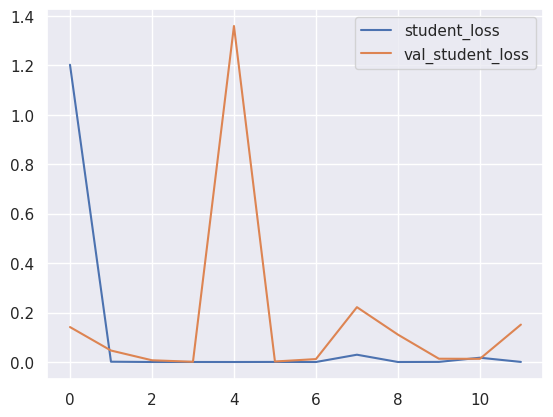

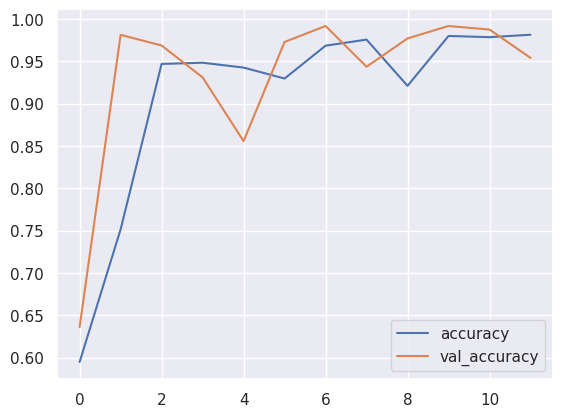

In [ ]:
distiller_history_2 = pd.DataFrame(distillation_history.history)
distiller_history_2.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history_2.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9624
Loss: 0.1138
Inference Time: 1.81s
Precision: 1.0000
Recall: 0.9012
F1-Score: 0.9481
AUC: 0.9506
MCC: 0.9218


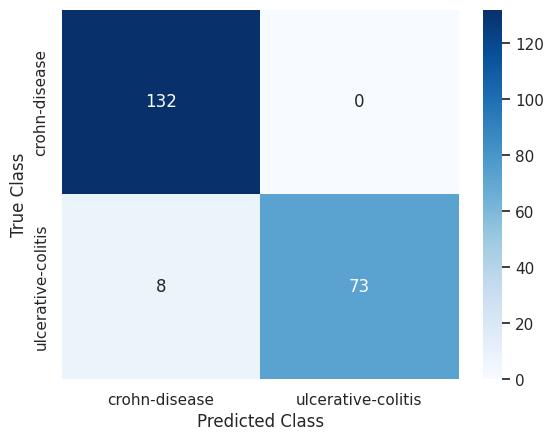

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_b32)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
46/46 [==============================] - 25s 343ms/step - accuracy: 0.5388 - student_loss: 0.8193 - distillation_loss: 0.9838 - val_accuracy: 0.8305 - val_student_loss: 0.6189 - val_distillation_loss: 0.0000e+00
Epoch 2/100
46/46 [==============================] - 15s 329ms/step - accuracy: 0.5920 - student_loss: 0.7343 - distillation_loss: 0.7826 - val_accuracy: 0.7155 - val_student_loss: 0.5550 - val_distillation_loss: 0.0000e+00
Epoch 3/100
46/46 [==============================] - 15s 324ms/step - accuracy: 0.6631 - student_loss: 0.6463 - distillation_loss: 0.7254 - val_accuracy: 0.7134 - val_student_loss: 0.5123 - val_distillation_loss: 0.0000e+00
Epoch 4/100
46/46 [==============================] - 15s 326ms/step - accuracy: 0.7198 - student_loss: 0.5872 - distillation_loss: 0.6537 - val_accuracy: 0.7490 - val_student_loss: 0.4702 - val_distillation_loss: 0.0000e+00
Epoch 5/100
46/46 [==============================] - 15s 324ms/step - accuracy: 0.7493 - student_loss: 0

<Axes: >

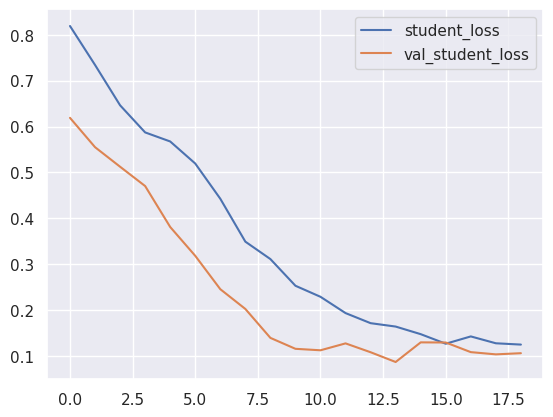

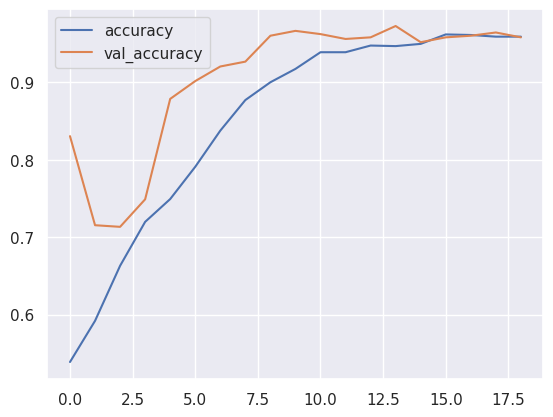

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9671
Loss: 0.0636
Inference Time: 0.93s
Precision: 0.9625
Recall: 0.9506
F1-Score: 0.9565
AUC: 0.9639
MCC: 0.9302


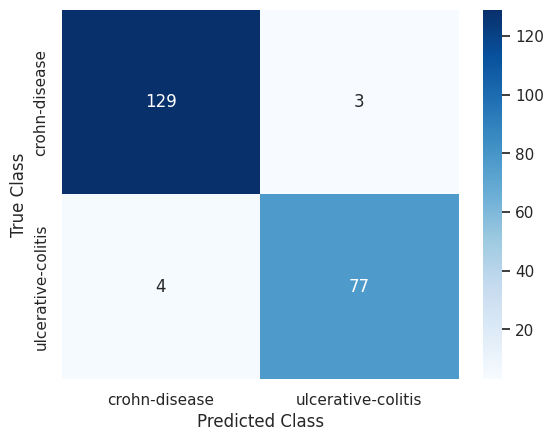

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

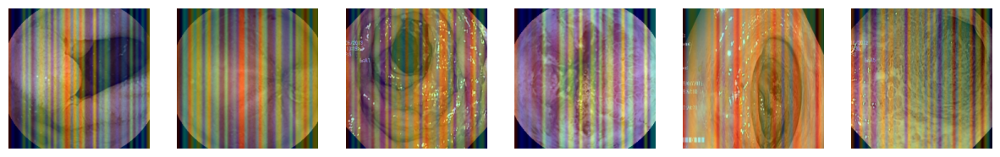

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_b32.layers[-1].activation = None

  preds = model_vit_b32.predict(img_array)
  heatmap = make_gradcam_heatmap_ViT(img_array, model_vit_b32, last_conv_layer_name)

  heatmap = np.reshape(heatmap, (-1,50))
  display_gradcam(_images, heatmap, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

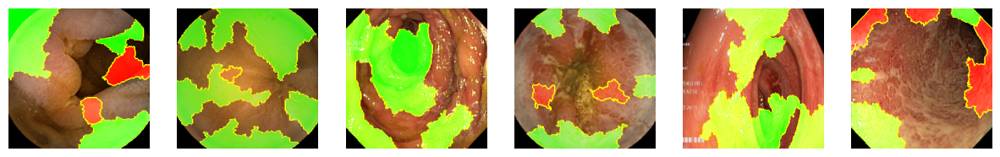

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_b32.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


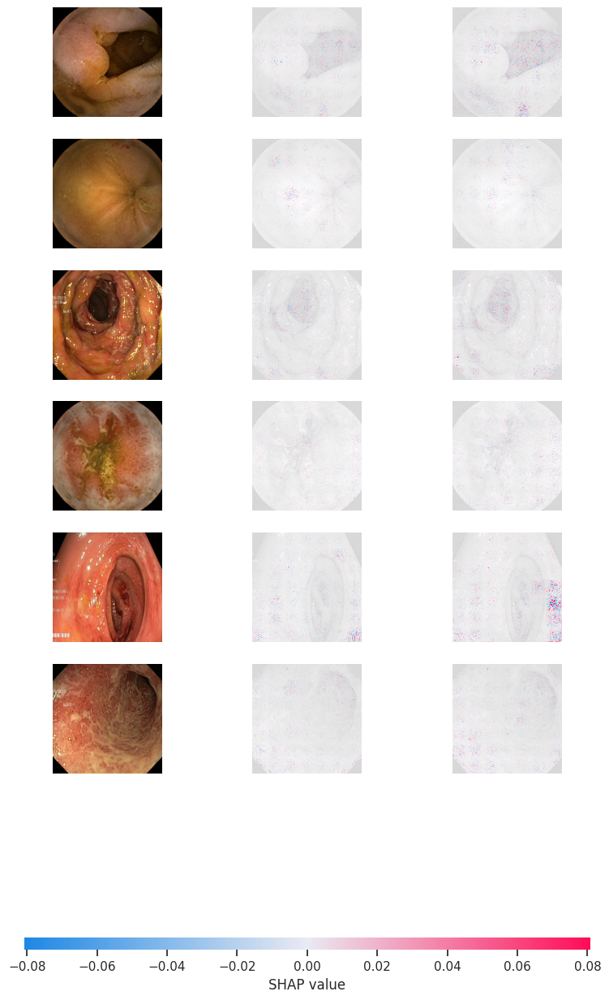

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_b32, images_train_1).shap_values(image_interpretability_4)
shap.image_plot(shap_values, image_interpretability_4)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_b32, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 469.00it/s]


Explaining: 100%|██████████| 32/32 [00:04<00:00,  6.64it/s]


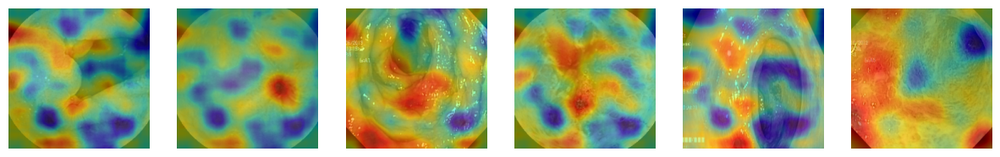

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

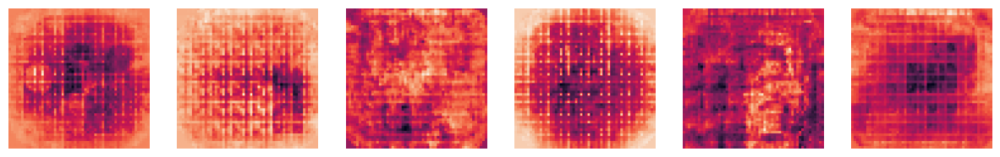

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_vit_b32, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

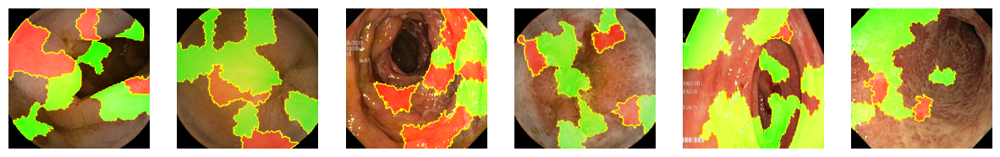

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 458.96it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 13.38it/s]


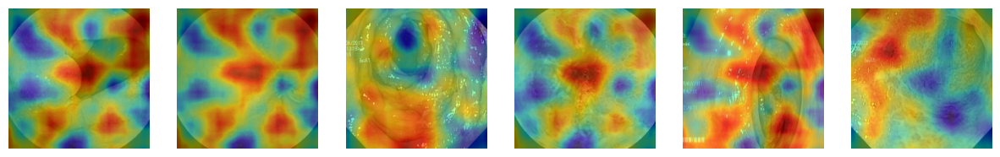

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

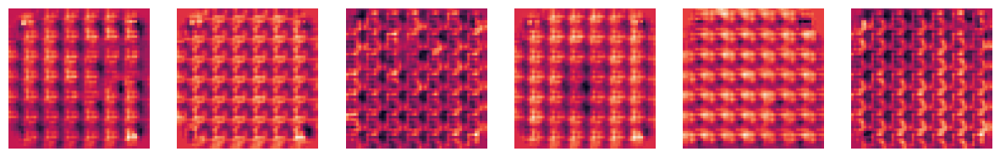

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h2>Interpretability of Second Student</h2>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

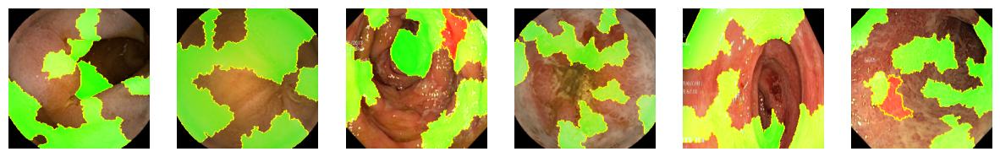

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 448.92it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 15.90it/s]


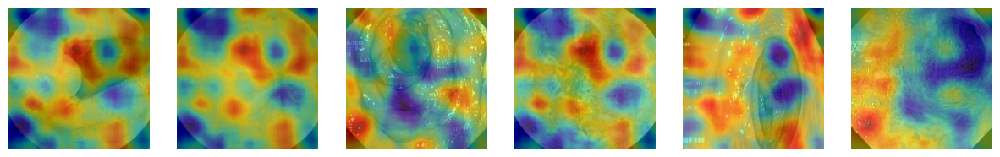

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

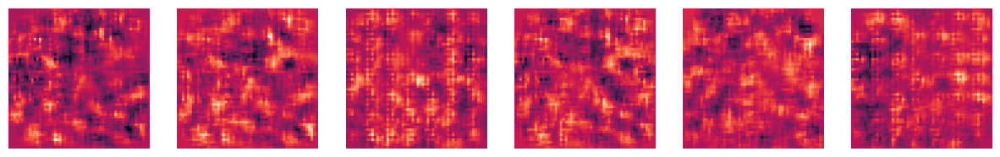

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# ViT_S/32

In [ ]:
vit_model_s32 = tfimm.create_model("vit_small_patch32_224_in21k", pretrained=True, nb_classes=0)
vit_model_s32_preprocessing = tfimm.create_preprocessing("vit_small_patch32_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_s32_preprocessing(x)
x = vit_model_s32.call(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_s32 = Model(inputs, outputs)

In [ ]:
model_vit_s32.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_s32.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_s32 = model_vit_s32.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 20s 286ms/step - loss: 0.1909 - accuracy: 0.9267 - val_loss: 0.0275 - val_accuracy: 0.9895
Epoch 2/200
23/23 [==============================] - 5s 195ms/step - loss: 0.0088 - accuracy: 0.9986 - val_loss: 0.0275 - val_accuracy: 0.9895
Epoch 3/200
23/23 [==============================] - 4s 183ms/step - loss: 0.0026 - accuracy: 1.0000 - val_loss: 0.0144 - val_accuracy: 0.9979
Epoch 4/200
23/23 [==============================] - 4s 180ms/step - loss: 0.0025 - accuracy: 0.9986 - val_loss: 0.0062 - val_accuracy: 0.9979
Epoch 5/200
23/23 [==============================] - 5s 186ms/step - loss: 0.0013 - accuracy: 1.0000 - val_loss: 0.0044 - val_accuracy: 1.0000
Epoch 6/200
23/23 [==============================] - 5s 185ms/step - loss: 0.0039 - accuracy: 0.9986 - val_loss: 0.0106 - val_accuracy: 0.9979
Epoch 7/200
23/23 [==============================] - 4s 179ms/step - loss: 0.0024 - accuracy: 1.0000 - val_loss: 0.0048 - val_accuracy: 0.995

<Axes: >

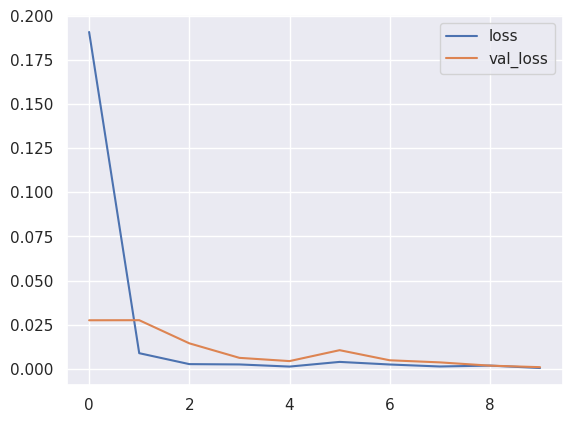

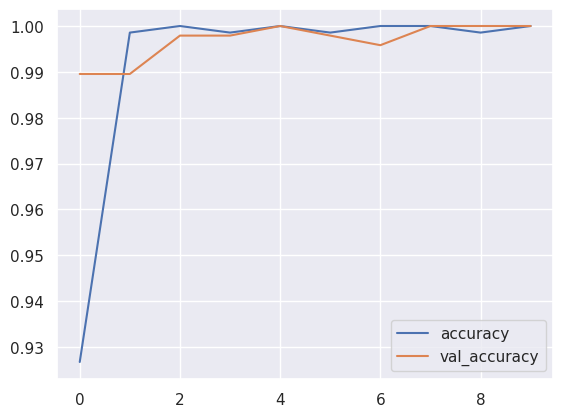

In [ ]:
model_history_s32 = pd.DataFrame(history_s32.history)
model_history_s32.loc[:, ['loss', 'val_loss']].plot()
model_history_s32.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_s32['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_s32['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_s32['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_s32['val_loss'].mean()))

Accuracy for Train: 0.9921
Loss for Train: 0.0216
Accuracy for Test: 0.9969
Loss for Test: 0.0102


In [ ]:
start = time.time()
predict_labels_ = model_vit_s32.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_s32 = np.argmax(model_vit_s32.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_s32)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_s32)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_s32)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_s32)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_s32)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_s32)))

Accuracy: 1.0000
Loss: 0.0007
Inference Time: 2.63s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


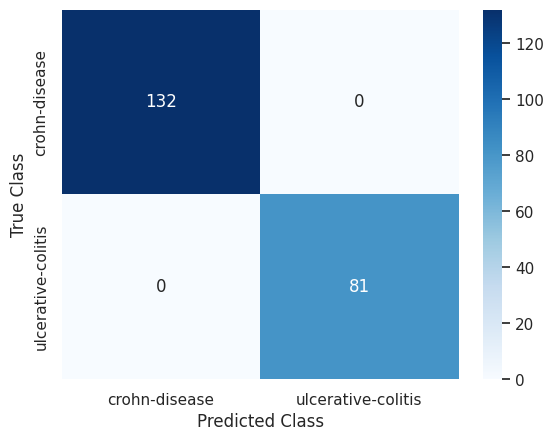

In [ ]:
conf_matrix_s32 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_s32), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_s32, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_s32.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_s32)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
23/23 [==============================] - 12s 132ms/step - accuracy: 0.5848 - student_loss: 1.2529 - distillation_loss: 15.9061 - val_accuracy: 0.4414 - val_student_loss: 0.1612
Epoch 2/100
23/23 [==============================] - 3s 103ms/step - accuracy: 0.6925 - student_loss: 0.7862 - distillation_loss: 12.5736 - val_accuracy: 0.7594 - val_student_loss: 0.0059
Epoch 3/100
23/23 [==============================] - 3s 111ms/step - accuracy: 0.9167 - student_loss: 0.2025 - distillation_loss: 5.4645 - val_accuracy: 0.8619 - val_student_loss: 2.7758e-05
Epoch 4/100
23/23 [==============================] - 3s 115ms/step - accuracy: 0.9483 - student_loss: 0.2259 - distillation_loss: 4.6372 - val_accuracy: 0.8075 - val_student_loss: 1.2048
Epoch 5/100
23/23 [==============================] - 3s 115ms/step - accuracy: 0.9339 - student_loss: 0.2000 - distillation_loss: 4.1647 - val_accuracy: 0.9833 - val_student_loss: 1.9572e-04
Epoch 6/100
23/23 [==============================] - 3

<Axes: >

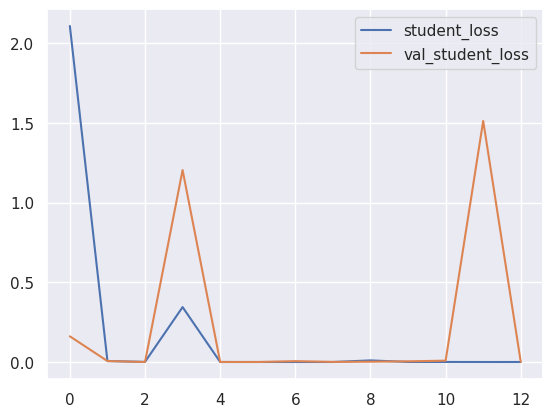

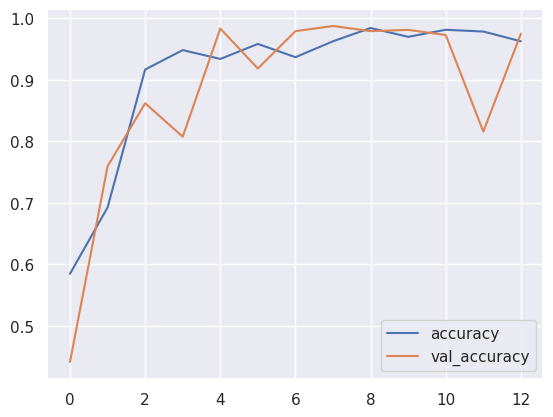

In [ ]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9085
Loss for Train: 0.1901
Accuracy for Test: 0.8817
Loss for Test: 0.2235


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9859
Loss: 0.0251
Inference Time: 1.31s
Precision: 0.9643
Recall: 1.0000
F1-Score: 0.9818
AUC: 0.9886
MCC: 0.9708


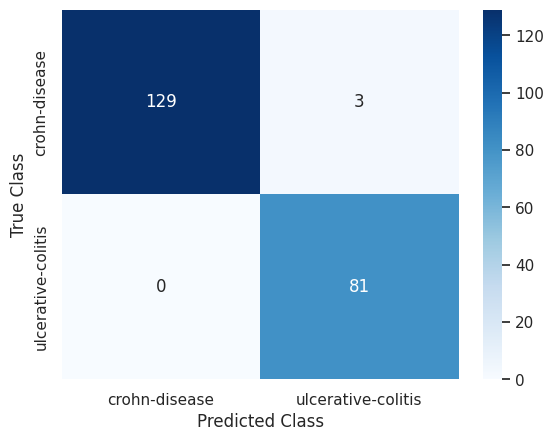

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_s32)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
46/46 [==============================] - 22s 293ms/step - accuracy: 0.5309 - student_loss: 0.8937 - distillation_loss: 0.8466 - val_accuracy: 0.5941 - val_student_loss: 0.6007 - val_distillation_loss: 0.0000e+00
Epoch 2/100
46/46 [==============================] - 13s 279ms/step - accuracy: 0.6078 - student_loss: 0.7697 - distillation_loss: 0.7620 - val_accuracy: 0.5900 - val_student_loss: 0.5533 - val_distillation_loss: 0.0000e+00
Epoch 3/100
46/46 [==============================] - 13s 277ms/step - accuracy: 0.6774 - student_loss: 0.6548 - distillation_loss: 0.6337 - val_accuracy: 0.7657 - val_student_loss: 0.4628 - val_distillation_loss: 0.0000e+00
Epoch 4/100
46/46 [==============================] - 13s 279ms/step - accuracy: 0.7299 - student_loss: 0.5824 - distillation_loss: 0.6008 - val_accuracy: 0.7678 - val_student_loss: 0.4146 - val_distillation_loss: 0.0000e+00
Epoch 5/100
46/46 [==============================] - 13s 277ms/step - accuracy: 0.7787 - student_loss: 0

<Axes: >

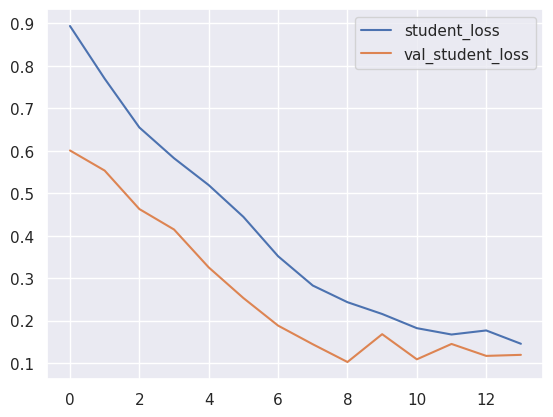

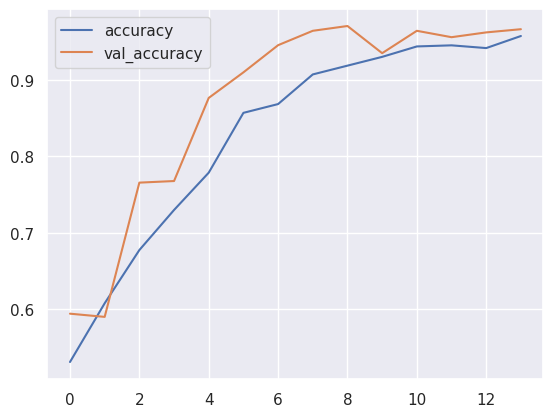

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8283
Loss for Train: 0.4021
Accuracy for Test: 0.8692
Loss for Test: 0.2646


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9671
Loss: 0.0983
Inference Time: 0.91s
Precision: 1.0000
Recall: 0.9136
F1-Score: 0.9548
AUC: 0.9568
MCC: 0.9314


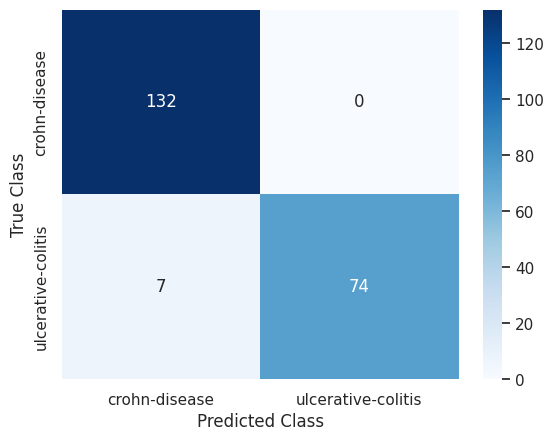

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease
crohn-disease
crohn-disease


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

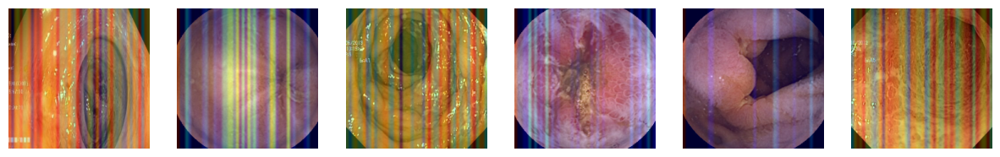

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_s32.layers[-1].activation = None

  preds = model_vit_s32.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_s32, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,50))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

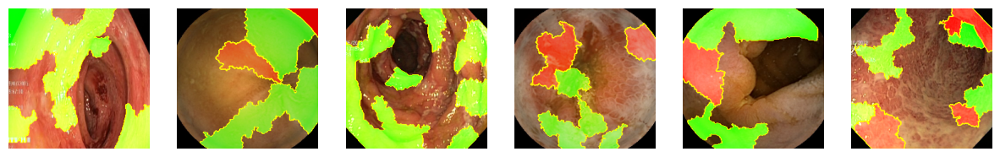

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_s32.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


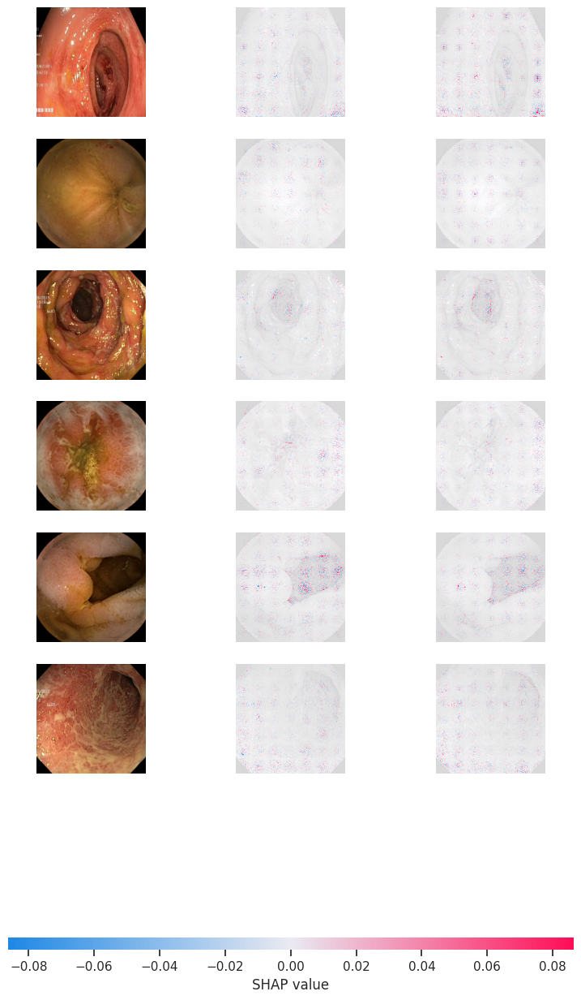

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_s32, images_train_1).shap_values(image_interpretability_4)
shap.image_plot(shap_values, image_interpretability_4)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_s32, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 396.49it/s]


Explaining: 100%|██████████| 32/32 [00:03<00:00, 10.02it/s]


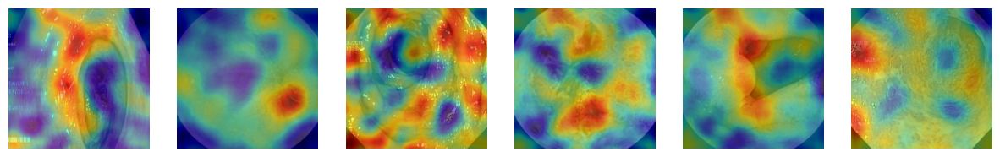

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

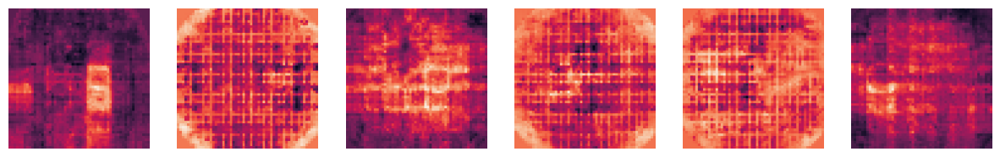

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_vit_s32, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

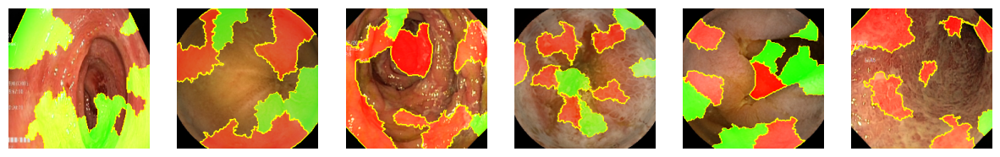

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 444.32it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 13.28it/s]


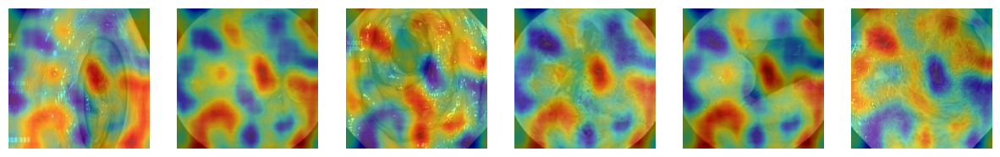

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

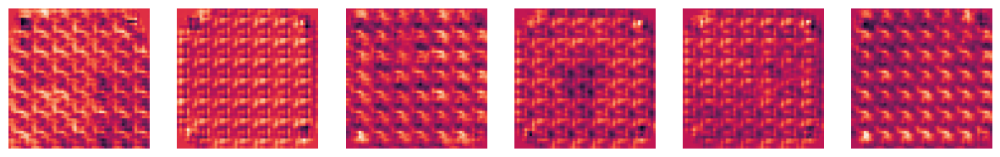

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

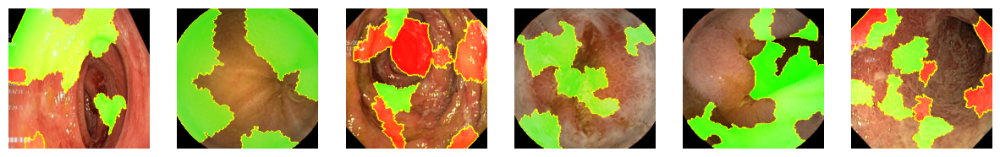

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 453.01it/s]


Explaining: 100%|██████████| 32/32 [00:01<00:00, 17.64it/s]


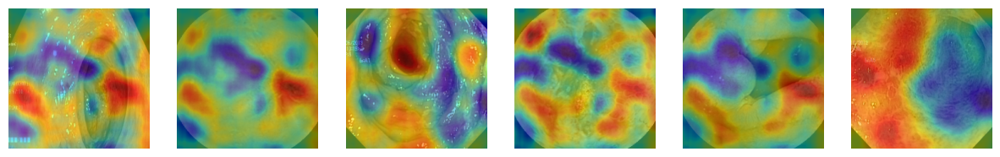

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Maps</h3>

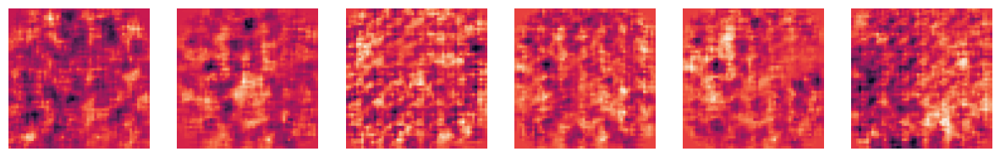

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# ViT_B/16

In [ ]:
vit_model_16 = tfimm.create_model("vit_base_patch16_224_in21k", pretrained=True, nb_classes=0)
vit_model_16_preprocessing = tfimm.create_preprocessing("vit_base_patch16_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_16_preprocessing(x)
x = vit_model_16.call(x)
x = layers.Dense(1000, activation="relu")(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_b16 = Model(inputs, outputs)

In [ ]:
model_vit_b16.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_b16.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_b16 = model_vit_b16.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 48s 2s/step - loss: 0.2235 - accuracy: 0.9310 - val_loss: 0.0056 - val_accuracy: 0.9979
Epoch 2/200
23/23 [==============================] - 36s 2s/step - loss: 0.0064 - accuracy: 0.9986 - val_loss: 0.0148 - val_accuracy: 0.9937
Epoch 3/200
23/23 [==============================] - 36s 2s/step - loss: 1.8644e-04 - accuracy: 1.0000 - val_loss: 0.0081 - val_accuracy: 0.9958
Epoch 4/200
23/23 [==============================] - 35s 2s/step - loss: 6.9020e-04 - accuracy: 1.0000 - val_loss: 3.3476e-04 - val_accuracy: 1.0000
Epoch 5/200
23/23 [==============================] - 36s 2s/step - loss: 7.0876e-05 - accuracy: 1.0000 - val_loss: 5.3583e-04 - val_accuracy: 1.0000
Epoch 6/200
23/23 [==============================] - 35s 2s/step - loss: 3.3665e-04 - accuracy: 1.0000 - val_loss: 0.0016 - val_accuracy: 1.0000
Epoch 7/200
23/23 [==============================] - 35s 2s/step - loss: 3.5526e-05 - accuracy: 1.0000 - val_loss: 0.0025 - val_ac

<Axes: >

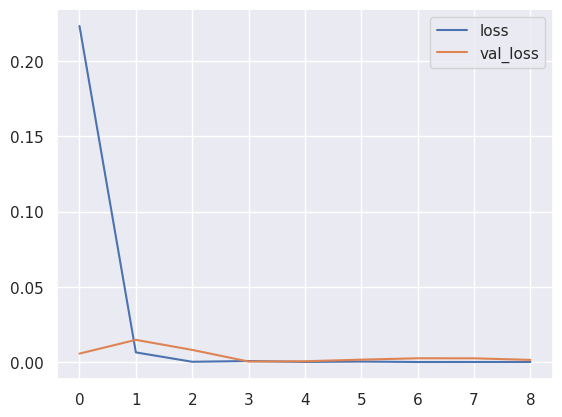

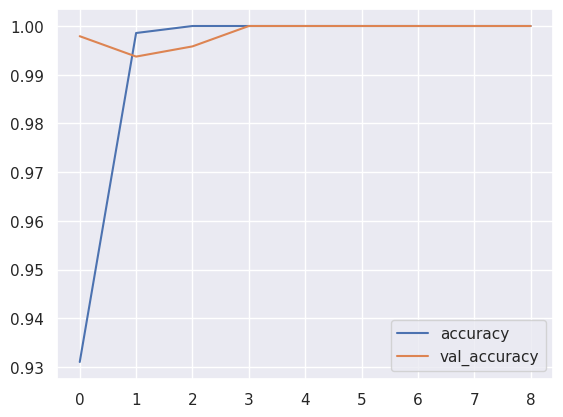

In [ ]:
model_history_b16 = pd.DataFrame(history_b16.history)
model_history_b16.loc[:, ['loss', 'val_loss']].plot()
model_history_b16.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_b16['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_b16['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_b16['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_b16['val_loss'].mean()))

Accuracy for Train: 0.9922
Loss for Train: 0.0257
Accuracy for Test: 0.9986
Loss for Test: 0.0042


In [ ]:
start = time.time()
predict_labels_ = model_vit_b16.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_b16 = np.argmax(model_vit_b16.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_b16)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_b16)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_b16)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_b16)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_b16)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_b16)))

Accuracy: 1.0000
Loss: 0.0029
Inference Time: 5.25s
Precision: 1.0000
Recall: 1.0000
F1-Score: 1.0000
AUC: 1.0000
MCC: 1.0000


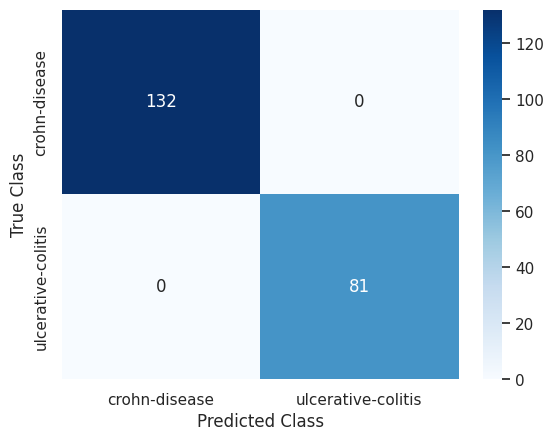

In [ ]:
conf_matrix_b16 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_b16), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_b16, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_b16.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ViT = Distiller(student=student_model_2, teacher=model_vit_b16)

distillation_ViT.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history_ViT = distillation_ViT.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
23/23 [==============================] - 20s 513ms/step - accuracy: 0.6394 - student_loss: 1.2058 - distillation_loss: 28.5241 - val_accuracy: 0.7720 - val_student_loss: 5.2536e-04
Epoch 2/100
23/23 [==============================] - 12s 491ms/step - accuracy: 0.8578 - student_loss: 0.4972 - distillation_loss: 12.4631 - val_accuracy: 0.9038 - val_student_loss: 3.5365e-07
Epoch 3/100
23/23 [==============================] - 12s 503ms/step - accuracy: 0.9497 - student_loss: 0.2039 - distillation_loss: 7.1966 - val_accuracy: 0.9854 - val_student_loss: 4.4248e-05
Epoch 4/100
23/23 [==============================] - 12s 496ms/step - accuracy: 0.9698 - student_loss: 0.0869 - distillation_loss: 5.5599 - val_accuracy: 0.9916 - val_student_loss: 8.0504e-06
Epoch 5/100
23/23 [==============================] - 12s 491ms/step - accuracy: 0.9727 - student_loss: 0.0776 - distillation_loss: 5.0496 - val_accuracy: 0.9749 - val_student_loss: 0.0416
Epoch 6/100
23/23 [=======================

<Axes: >

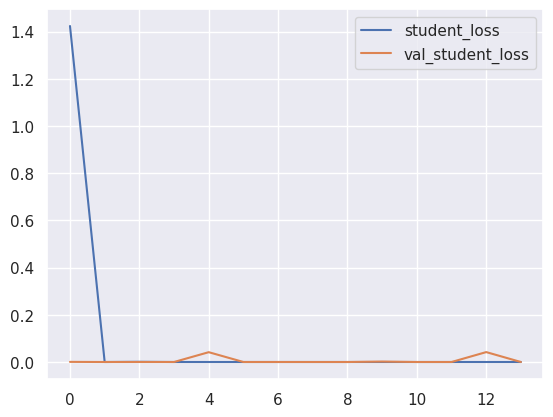

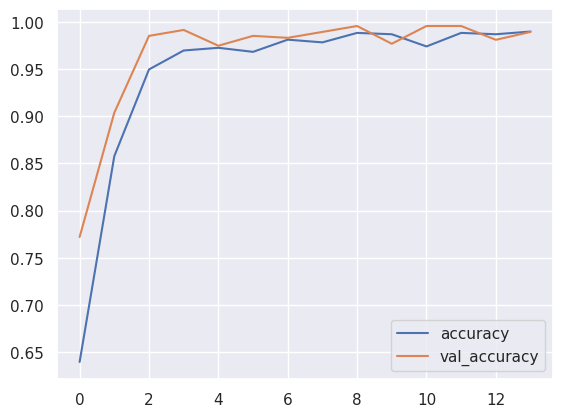

In [ ]:
distiller_history = pd.DataFrame(distillation_history_ViT.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9452
Loss for Train: 0.1018
Accuracy for Test: 0.9658
Loss for Test: 0.0062


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_ViT.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_ViT.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9953
Loss: 0.0132
Inference Time: 1.74s
Precision: 0.9878
Recall: 1.0000
F1-Score: 0.9939
AUC: 0.9962
MCC: 0.9901


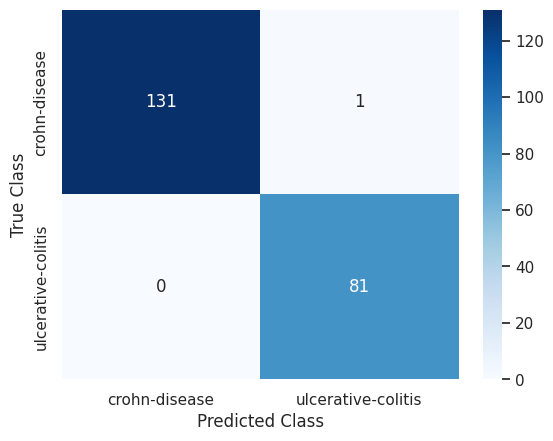

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_ViT.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_b16)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
46/46 [==============================] - 41s 711ms/step - accuracy: 0.4454 - student_loss: 1.3512 - distillation_loss: 0.7949 - val_accuracy: 0.5941 - val_student_loss: 0.6790 - val_distillation_loss: 0.0000e+00
Epoch 2/100
46/46 [==============================] - 33s 714ms/step - accuracy: 0.5079 - student_loss: 0.9206 - distillation_loss: 0.7501 - val_accuracy: 0.5732 - val_student_loss: 0.6522 - val_distillation_loss: 0.0000e+00
Epoch 3/100
46/46 [==============================] - 32s 701ms/step - accuracy: 0.5560 - student_loss: 0.8428 - distillation_loss: 0.7297 - val_accuracy: 0.5941 - val_student_loss: 0.6180 - val_distillation_loss: 0.0000e+00
Epoch 4/100
46/46 [==============================] - 32s 703ms/step - accuracy: 0.5948 - student_loss: 0.8002 - distillation_loss: 0.6937 - val_accuracy: 0.5837 - val_student_loss: 0.6012 - val_distillation_loss: 0.0000e+00
Epoch 5/100
46/46 [==============================] - 32s 703ms/step - accuracy: 0.6178 - student_loss: 0

<Axes: >

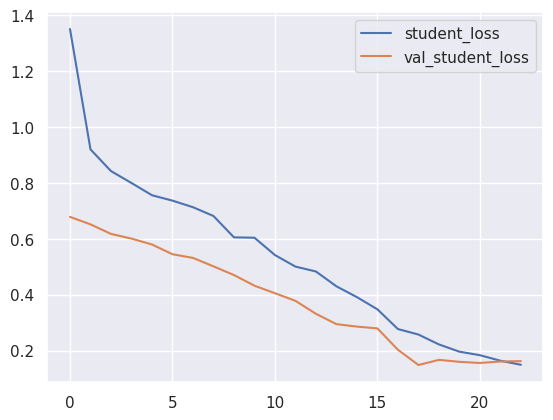

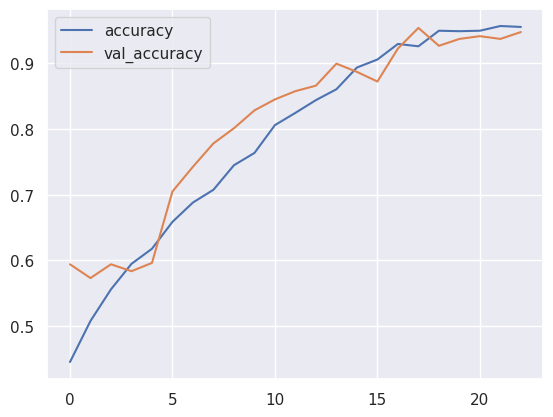

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.7842
Loss for Train: 0.5289
Accuracy for Test: 0.8084
Loss for Test: 0.3805


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9577
Loss: 0.1023
Inference Time: 1.03s
Precision: 1.0000
Recall: 0.8889
F1-Score: 0.9412
AUC: 0.9444
MCC: 0.9122


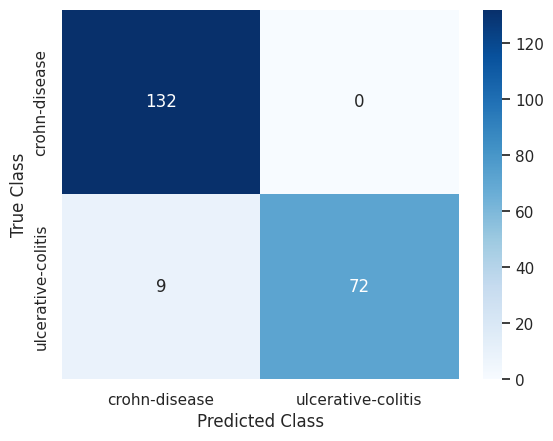

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease
crohn-disease


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

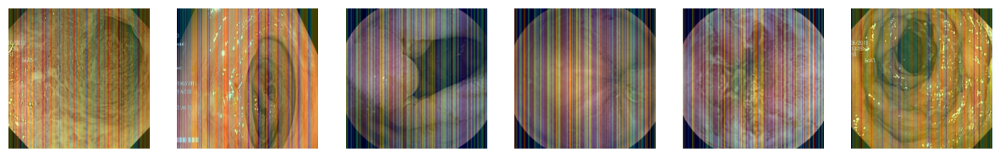

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4[:6], axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_b16.layers[-1].activation = None

  preds = model_vit_b16.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_b16, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,197))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

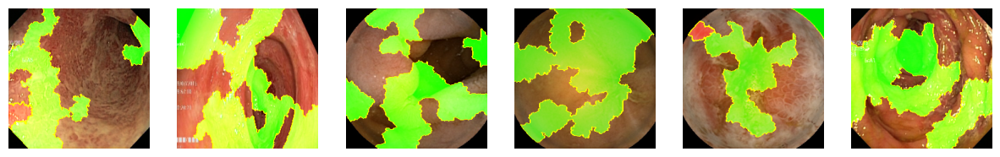

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_b16.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


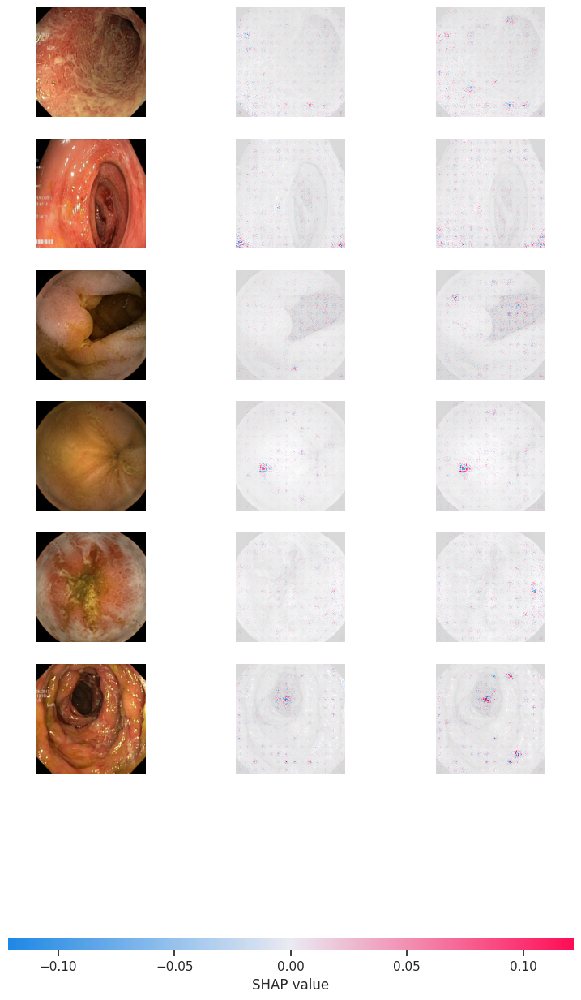

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_b16, images_train_1).shap_values(image_interpretability_4)
shap.image_plot(shap_values, image_interpretability_4)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_b16, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 451.83it/s]


Explaining: 100%|██████████| 32/32 [00:15<00:00,  2.10it/s]


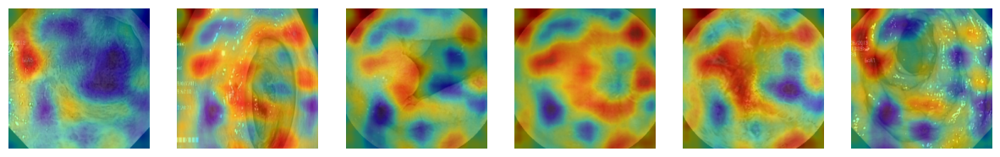

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

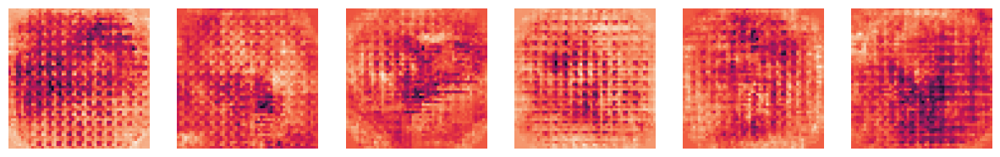

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(model_vit_b16, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

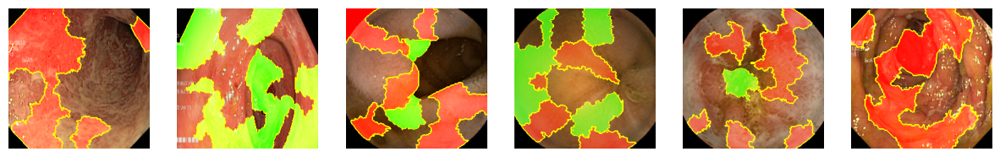

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 419.90it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 12.12it/s]


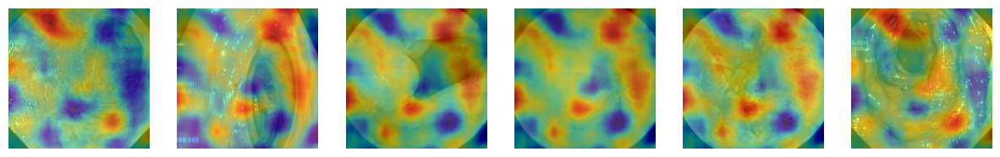

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

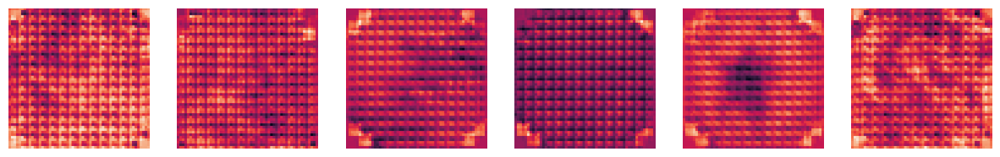

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

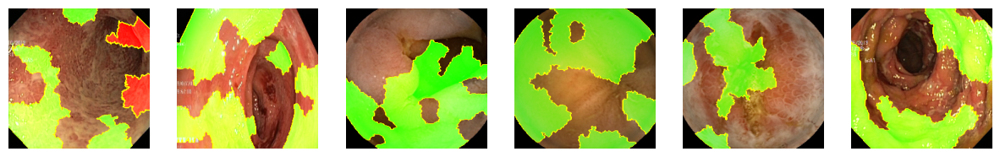

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1,6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_ViT.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_ViT, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 429.99it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 15.68it/s]


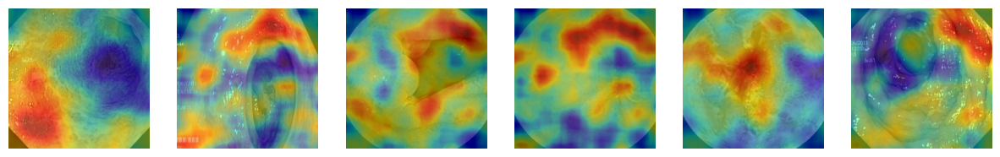

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivy</h3>

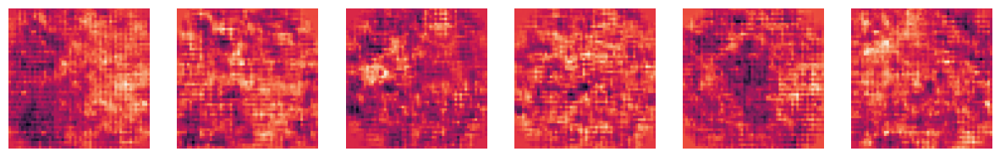

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_ViT, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# ViT_S/16

In [12]:
vit_model_s16 = tfimm.create_model("vit_small_patch16_224_in21k", pretrained=True, nb_classes=0)
vit_model_s16_preprocessing = tfimm.create_preprocessing("vit_small_patch16_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_s16_preprocessing(x)
x = vit_model_s16.call(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_s16 = Model(inputs, outputs)

In [13]:
model_vit_s16.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [14]:
model_vit_s16.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [15]:
history_s16 = model_vit_s16.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 27s 640ms/step - loss: 0.1948 - accuracy: 0.9152 - val_loss: 0.0134 - val_accuracy: 1.0000
Epoch 2/200
23/23 [==============================] - 13s 550ms/step - loss: 0.0063 - accuracy: 0.9986 - val_loss: 0.0033 - val_accuracy: 1.0000
Epoch 3/200
23/23 [==============================] - 13s 551ms/step - loss: 0.0010 - accuracy: 1.0000 - val_loss: 0.0025 - val_accuracy: 1.0000
Epoch 4/200
23/23 [==============================] - 13s 560ms/step - loss: 0.0016 - accuracy: 1.0000 - val_loss: 0.0019 - val_accuracy: 1.0000
Epoch 5/200
23/23 [==============================] - 13s 573ms/step - loss: 0.0014 - accuracy: 1.0000 - val_loss: 0.0071 - val_accuracy: 0.9979
Epoch 6/200
23/23 [==============================] - 13s 570ms/step - loss: 8.0319e-04 - accuracy: 1.0000 - val_loss: 0.0034 - val_accuracy: 1.0000


<Axes: >

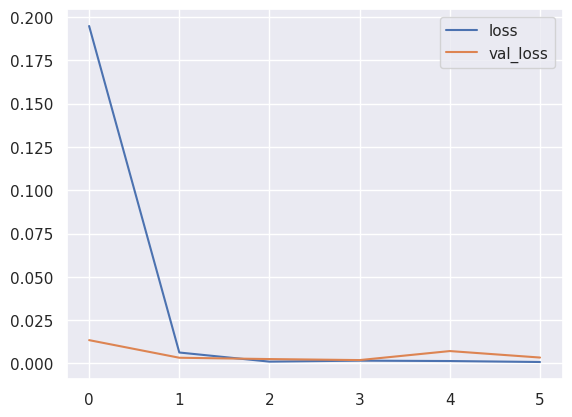

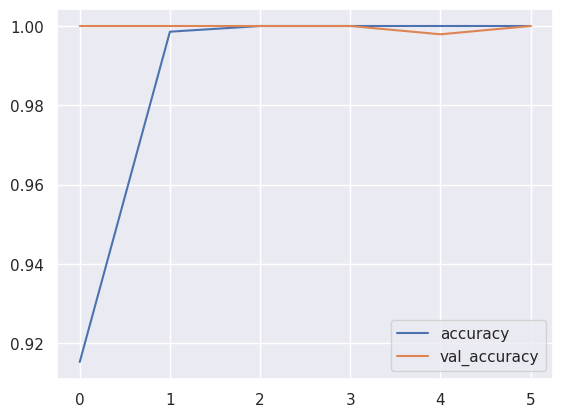

In [16]:
model_history_s16 = pd.DataFrame(history_s16.history)
model_history_s16.loc[:, ['loss', 'val_loss']].plot()
model_history_s16.loc[:, ['accuracy', 'val_accuracy']].plot()

In [17]:
print('Accuracy for Train: {:.4f}'.format(model_history_s16['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_s16['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_s16['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_s16['val_loss'].mean()))

Accuracy for Train: 0.9856
Loss for Train: 0.0343
Accuracy for Test: 0.9997
Loss for Test: 0.0053


In [18]:
start = time.time()
predict_labels_ = model_vit_s16.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_s16 = np.argmax(model_vit_s16.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_s16)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_s16)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_s16)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_s16)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_s16)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_s16)))

Accuracy: 0.9953
Loss: 0.0097
Inference Time: 3.26s
Precision: 0.9878
Recall: 1.0000
F1-Score: 0.9939
AUC: 0.9962
MCC: 0.9901


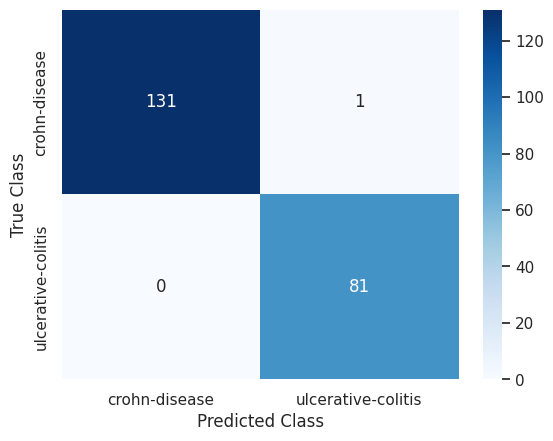

In [19]:
conf_matrix_s16 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_s16), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_s16, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [20]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_s16.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation</h1>

In [21]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_s16)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [22]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
23/23 [==============================] - 14s 254ms/step - accuracy: 0.6034 - student_loss: 1.0412 - distillation_loss: 11.6613 - val_accuracy: 0.5962 - val_student_loss: 0.0027
Epoch 2/100
23/23 [==============================] - 5s 220ms/step - accuracy: 0.8204 - student_loss: 0.5723 - distillation_loss: 7.8283 - val_accuracy: 0.9812 - val_student_loss: 0.0012
Epoch 3/100
23/23 [==============================] - 5s 216ms/step - accuracy: 0.9224 - student_loss: 0.2278 - distillation_loss: 4.4245 - val_accuracy: 0.9791 - val_student_loss: 0.0178
Epoch 4/100
23/23 [==============================] - 5s 226ms/step - accuracy: 0.9483 - student_loss: 0.1368 - distillation_loss: 3.4203 - val_accuracy: 0.9435 - val_student_loss: 0.0465
Epoch 5/100
23/23 [==============================] - 6s 234ms/step - accuracy: 0.9483 - student_loss: 0.1423 - distillation_loss: 4.1044 - val_accuracy: 0.9854 - val_student_loss: 3.5279e-04
Epoch 6/100
23/23 [==============================] - 5s 220

<Axes: >

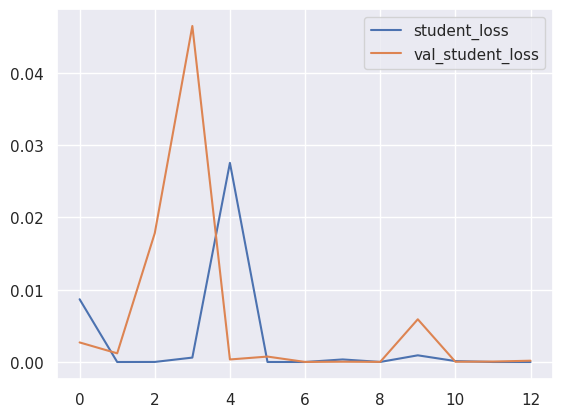

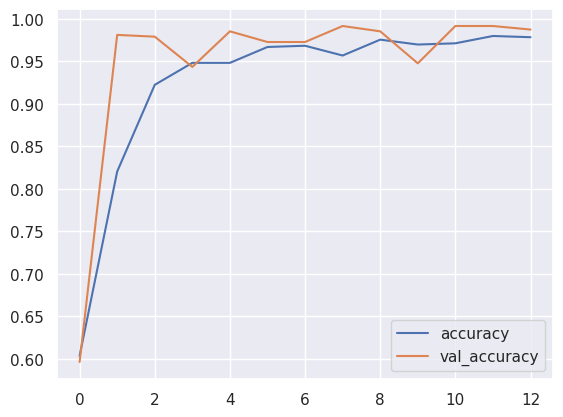

In [23]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [24]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9239
Loss for Train: 0.0029
Accuracy for Test: 0.9482
Loss for Test: 0.0058


In [25]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9906
Loss: 0.0147
Inference Time: 0.91s
Precision: 1.0000
Recall: 0.9753
F1-Score: 0.9875
AUC: 0.9877
MCC: 0.9802


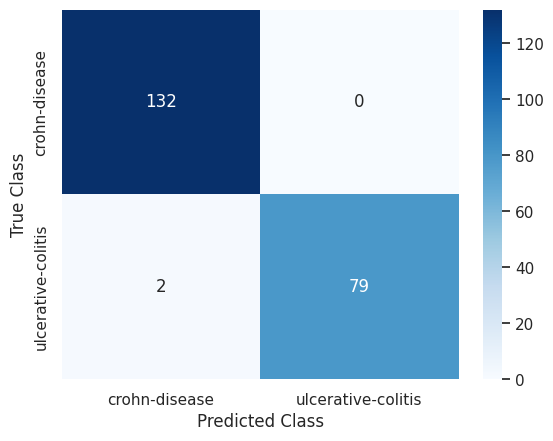

In [26]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [27]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Knowledge Distillation through attention</h1>

In [28]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [29]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_s16)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [30]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
46/46 [==============================] - 29s 449ms/step - accuracy: 0.4971 - student_loss: 0.9153 - distillation_loss: 0.8119 - val_accuracy: 0.5586 - val_student_loss: 0.7527 - val_distillation_loss: 0.0000e+00
Epoch 2/100
46/46 [==============================] - 20s 442ms/step - accuracy: 0.5654 - student_loss: 0.8070 - distillation_loss: 0.7625 - val_accuracy: 0.5669 - val_student_loss: 0.6972 - val_distillation_loss: 0.0000e+00
Epoch 3/100
46/46 [==============================] - 21s 448ms/step - accuracy: 0.5884 - student_loss: 0.7387 - distillation_loss: 0.7492 - val_accuracy: 0.5649 - val_student_loss: 0.6722 - val_distillation_loss: 0.0000e+00
Epoch 4/100
46/46 [==============================] - 20s 438ms/step - accuracy: 0.6142 - student_loss: 0.7318 - distillation_loss: 0.7318 - val_accuracy: 0.5565 - val_student_loss: 0.6630 - val_distillation_loss: 0.0000e+00
Epoch 5/100
46/46 [==============================] - 21s 448ms/step - accuracy: 0.6473 - student_loss: 0

<Axes: >

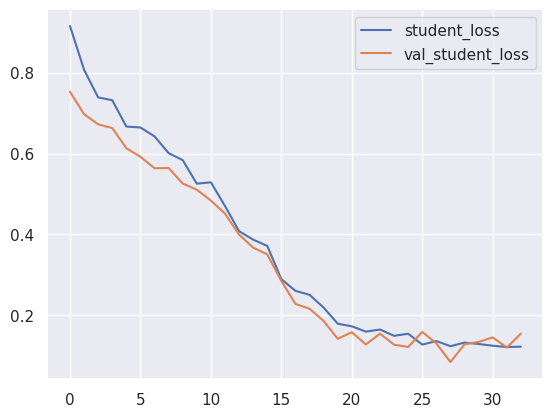

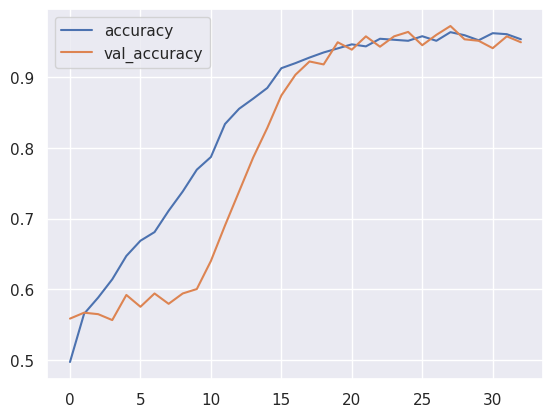

In [31]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [32]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8414
Loss for Train: 0.3655
Accuracy for Test: 0.8010
Loss for Test: 0.3337


In [33]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9624
Loss: 0.0849
Inference Time: 1.01s
Precision: 1.0000
Recall: 0.9012
F1-Score: 0.9481
AUC: 0.9506
MCC: 0.9218


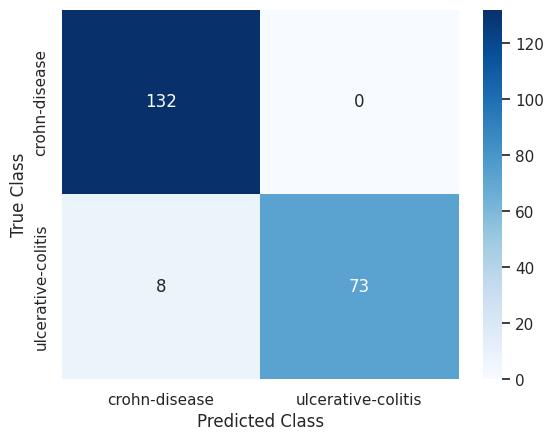

In [34]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [35]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

crohn-disease
crohn-disease
crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

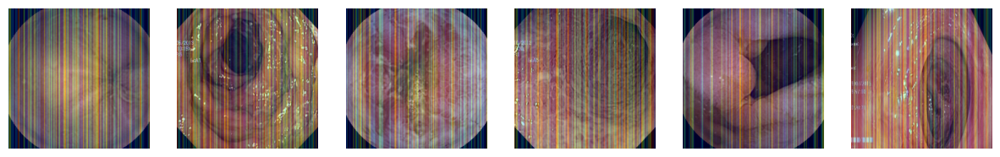

In [36]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_s16.layers[-1].activation = None

  preds = model_vit_s16.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_s16, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,197))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

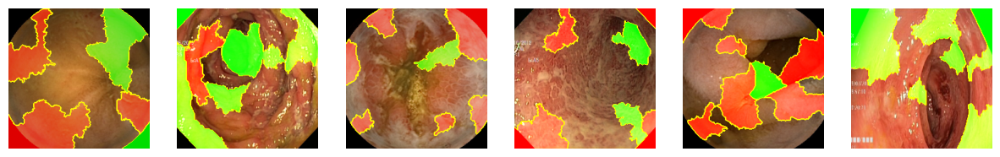

In [37]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_s16.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


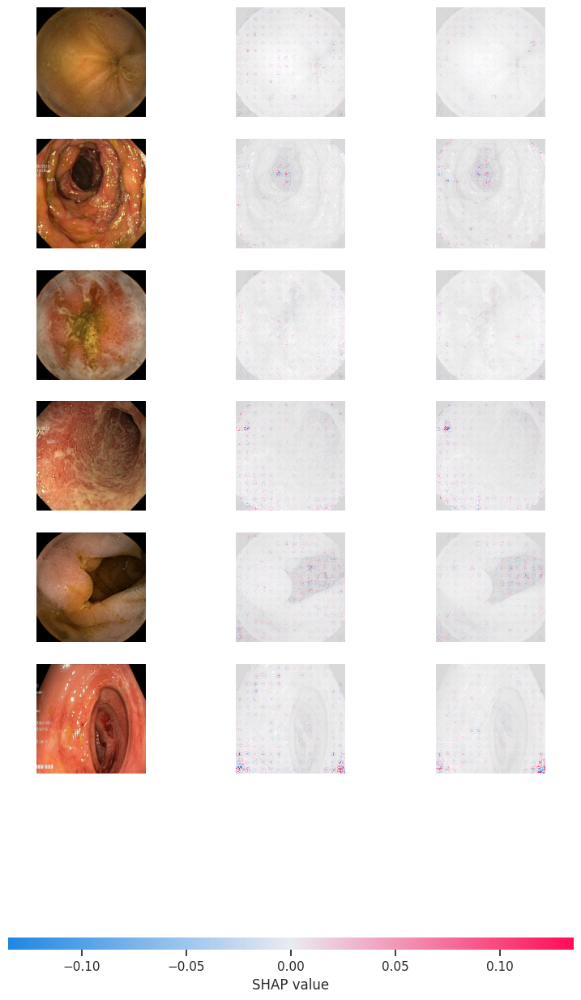

In [38]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_s16, images_train_1).shap_values(image_interpretability_4)
shap.image_plot(shap_values, image_interpretability_4)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [39]:
model_rise = RISE(1000, 8, 0.5, model_vit_s16, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 453.83it/s]


Explaining: 100%|██████████| 32/32 [00:06<00:00,  5.01it/s]


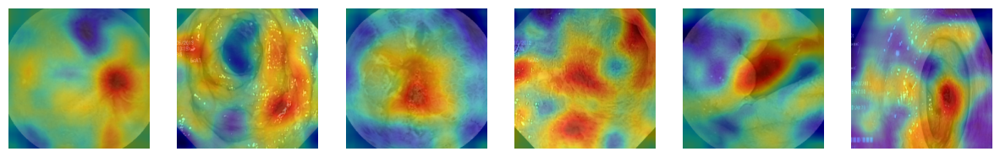

In [40]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

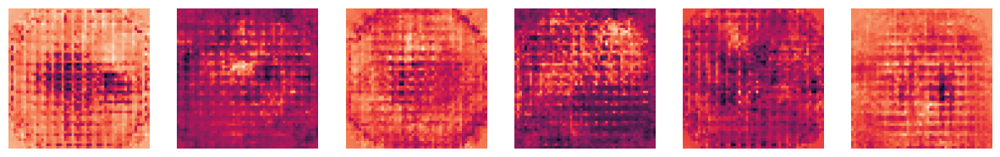

In [41]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(model_vit_s16, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

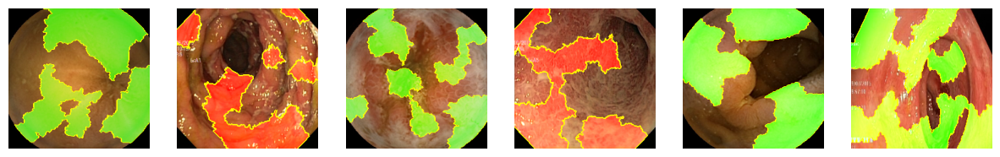

In [42]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [43]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 440.62it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 11.53it/s]


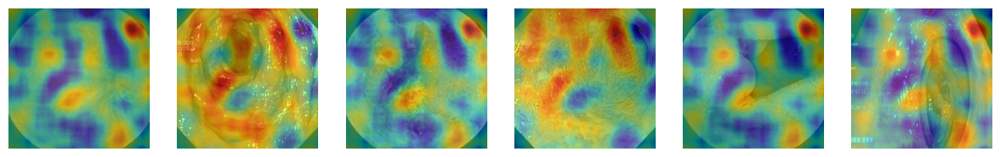

In [44]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

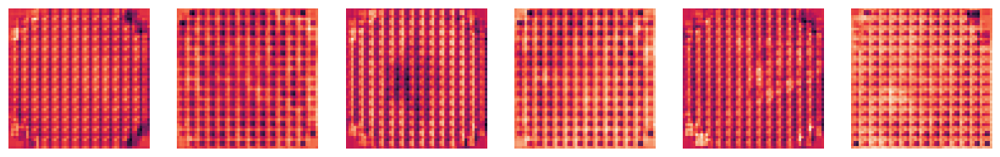

In [45]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

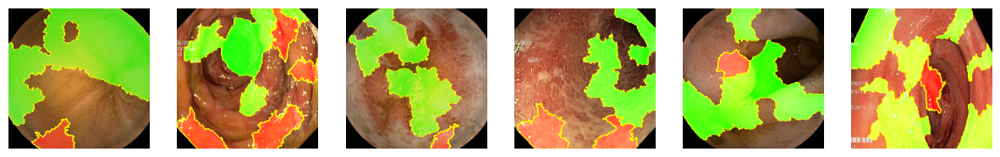

In [46]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [47]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 420.92it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 14.09it/s]


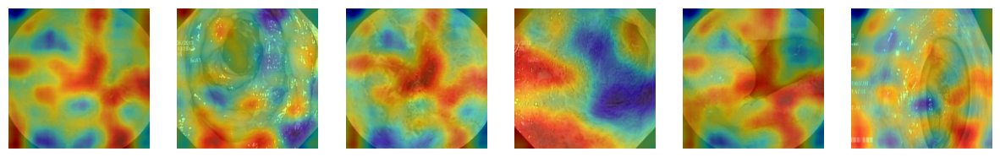

In [48]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

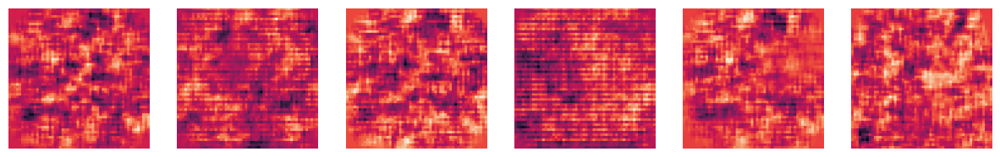

In [49]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

# R26+S/32

In [ ]:
vit_model_hybrid_s32 = tfimm.create_model("vit_small_r26_s32_224_in21k", pretrained=True, nb_classes=0)
vit_model_hybrid_s32_preprocessing = tfimm.create_preprocessing("vit_small_r26_s32_224_in21k")

inputs = Input(shape=IMG_SIZE + (3,))
x = data_augmentation(inputs)
x = vit_model_hybrid_s32_preprocessing(x)
x = vit_model_hybrid_s32.call(x)
outputs = layers.Dense(len(class_names))(x)

model_vit_hybrid_s32 = Model(inputs, outputs)

In [ ]:
model_vit_hybrid_s32.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 224, 224, 3)  0           ['input_7[0][0]']                
                                                                                                  
 tf.cast_2 (TFOpLambda)         (None, 224, 224, 3)  0           ['sequential[1][0]']             
                                                                                                  
 tf.math.truediv (TFOpLambda)   (None, 224, 224, 3)  0           ['tf.cast_2[0][0]']        

In [ ]:
model_vit_hybrid_s32.compile(loss=SparseCategoricalCrossentropy(from_logits=True), optimizer=Adam(learning_rate=1e-5), metrics=['accuracy'])

In [ ]:
history_hybrid_s32 = model_vit_hybrid_s32.fit(train_ds, epochs=200, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/200
23/23 [==============================] - 48s 993ms/step - loss: 0.2293 - accuracy: 0.9195 - val_loss: 0.0115 - val_accuracy: 1.0000
Epoch 2/200
23/23 [==============================] - 15s 631ms/step - loss: 0.0086 - accuracy: 0.9986 - val_loss: 0.0176 - val_accuracy: 0.9958
Epoch 3/200
23/23 [==============================] - 15s 635ms/step - loss: 0.0066 - accuracy: 0.9986 - val_loss: 0.0066 - val_accuracy: 1.0000
Epoch 4/200
23/23 [==============================] - 15s 642ms/step - loss: 0.0017 - accuracy: 1.0000 - val_loss: 0.0123 - val_accuracy: 0.9979
Epoch 5/200
23/23 [==============================] - 15s 651ms/step - loss: 0.0011 - accuracy: 1.0000 - val_loss: 0.0099 - val_accuracy: 0.9958
Epoch 6/200
23/23 [==============================] - 16s 666ms/step - loss: 0.0015 - accuracy: 1.0000 - val_loss: 0.0129 - val_accuracy: 0.9958


<Axes: >

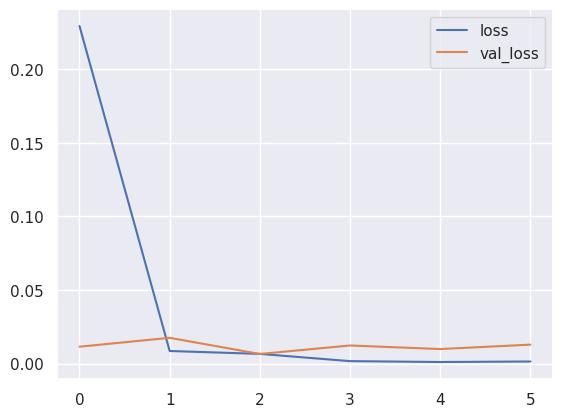

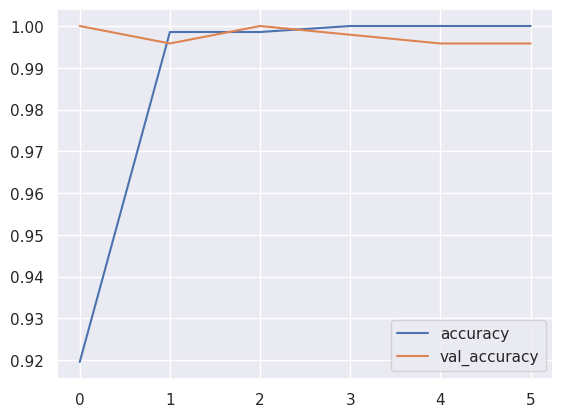

In [ ]:
model_history_hybrid_s32 = pd.DataFrame(history_hybrid_s32.history)
model_history_hybrid_s32.loc[:, ['loss', 'val_loss']].plot()
model_history_hybrid_s32.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(model_history_hybrid_s32['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(model_history_hybrid_s32['loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(model_history_hybrid_s32['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(model_history_hybrid_s32['val_loss'].mean()))

Accuracy for Train: 0.9861
Loss for Train: 0.0415
Accuracy for Test: 0.9976
Loss for Test: 0.0118


In [ ]:
start = time.time()
predict_labels_ = model_vit_hybrid_s32.predict(true_images)
duration = time.time() - start

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_1 = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_1,predict_labels_)

predict_labels_hybrid_s32 = np.argmax(model_vit_hybrid_s32.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_hybrid_s32)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_hybrid_s32)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_hybrid_s32)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_hybrid_s32)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_hybrid_s32)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_hybrid_s32)))

Accuracy: 0.9953
Loss: 0.0169
Inference Time: 5.88s
Precision: 0.9878
Recall: 1.0000
F1-Score: 0.9939
AUC: 0.9962
MCC: 0.9901


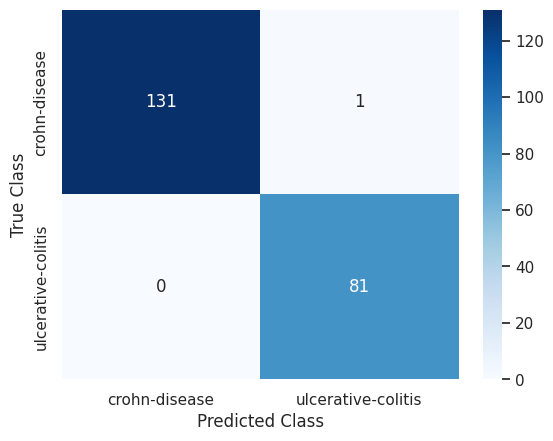

In [ ]:
conf_matrix_hybrid_s32 = pd.DataFrame(confusion_matrix(true_labels, predict_labels_hybrid_s32), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_hybrid_s32, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds = model_vit_hybrid_s32.predict(img_array)
  if np.argmax(preds, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
ulcerative-colitis
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease


<h1>Knowledge Distillation</h1>

In [ ]:
distillation_ = Distiller(student=student_model_2, teacher=model_vit_hybrid_s32)

distillation_.compile(
    optimizer=Adam(learning_rate=1e-4),
    metrics=['accuracy'],
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True), 
    distillation_loss_fn=KLDivergence(),
    alpha=0.8,
    temperature=105)

In [ ]:
distillation_history = distillation_.fit(train_ds, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
23/23 [==============================] - 17s 264ms/step - accuracy: 0.5675 - student_loss: 1.0828 - distillation_loss: 16.1592 - val_accuracy: 0.7343 - val_student_loss: 0.0602
Epoch 2/100
23/23 [==============================] - 6s 249ms/step - accuracy: 0.7816 - student_loss: 0.5747 - distillation_loss: 9.3943 - val_accuracy: 0.4854 - val_student_loss: 5.4359e-05
Epoch 3/100
23/23 [==============================] - 6s 240ms/step - accuracy: 0.7644 - student_loss: 0.8298 - distillation_loss: 10.0346 - val_accuracy: 0.9059 - val_student_loss: 0.0153
Epoch 4/100
23/23 [==============================] - 6s 248ms/step - accuracy: 0.8894 - student_loss: 0.3893 - distillation_loss: 4.7663 - val_accuracy: 0.9749 - val_student_loss: 0.0144
Epoch 5/100
23/23 [==============================] - 6s 237ms/step - accuracy: 0.9583 - student_loss: 0.1055 - distillation_loss: 2.9300 - val_accuracy: 0.9833 - val_student_loss: 0.0010
Epoch 6/100
23/23 [==============================] - 6s 24

<Axes: >

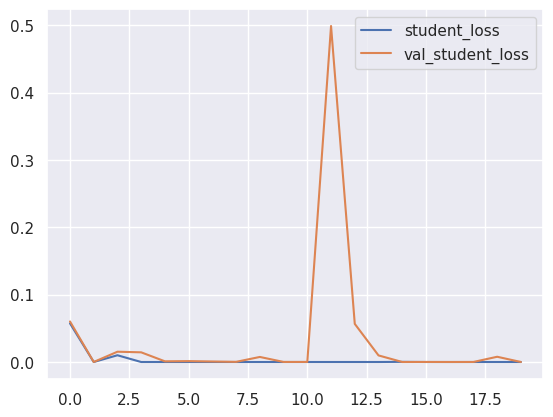

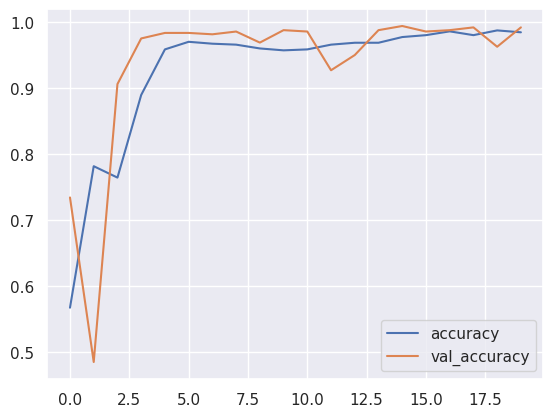

In [ ]:
distiller_history = pd.DataFrame(distillation_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.9267
Loss for Train: 0.0034
Accuracy for Test: 0.9376
Loss for Test: 0.0337


In [ ]:
start_dist = time.time()
predict_labels_dist = distillation_.predict(true_images)
duration_dist = time.time() - start_dist

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist = tf.reshape(true_labels, (-1,))
loss_dist = loss_object(true_labels_dist,predict_labels_dist)

predict_labels_distiller_2 = np.argmax(distillation_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller_2)))
print("Loss: {:0.4f}".format(loss_dist))
print("Inference Time: {:.2f}s".format(duration_dist))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller_2)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller_2)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller_2)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller_2)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller_2)))

Accuracy: 0.9953
Loss: 0.0097
Inference Time: 1.42s
Precision: 1.0000
Recall: 0.9877
F1-Score: 0.9938
AUC: 0.9938
MCC: 0.9901


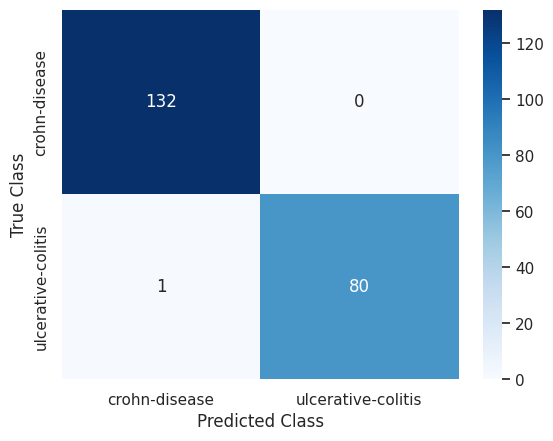

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller_2), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist = distillation_.predict(img_array)
  if np.argmax(preds_dist, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease
ulcerative-colitis
crohn-disease


<h1>Knowledge Distillation through attention</h1>

In [ ]:
inputs_train = train_ds.map(lambda x,y: (data_augmentation(x, training=True), y))
train_ds_distilled = train_ds.concatenate(inputs_train)

In [ ]:
deit_ = DeiT(student=ViTDistilled(), teacher=model_vit_hybrid_s32)


deit_.compile(
    optimizer=AdamW(weight_decay=WEIGHT_DECAY, learning_rate=lr_scaled),
    student_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=SparseCategoricalCrossentropy(from_logits=True),
    metrics=["accuracy"],
)

In [ ]:
deit_history = deit_.fit(train_ds_distilled, epochs=100, validation_data=test_ds, callbacks=[early_stopping])

Epoch 1/100
46/46 [==============================] - 29s 408ms/step - accuracy: 0.5517 - student_loss: 0.8709 - distillation_loss: 0.8106 - val_accuracy: 0.5690 - val_student_loss: 0.6129 - val_distillation_loss: 0.0000e+00
Epoch 2/100
46/46 [==============================] - 18s 399ms/step - accuracy: 0.6422 - student_loss: 0.7571 - distillation_loss: 0.6747 - val_accuracy: 0.6067 - val_student_loss: 0.5545 - val_distillation_loss: 0.0000e+00
Epoch 3/100
46/46 [==============================] - 19s 401ms/step - accuracy: 0.6983 - student_loss: 0.6403 - distillation_loss: 0.6537 - val_accuracy: 0.7029 - val_student_loss: 0.4842 - val_distillation_loss: 0.0000e+00
Epoch 4/100
46/46 [==============================] - 18s 399ms/step - accuracy: 0.7658 - student_loss: 0.5967 - distillation_loss: 0.5556 - val_accuracy: 0.8577 - val_student_loss: 0.4070 - val_distillation_loss: 0.0000e+00
Epoch 5/100
46/46 [==============================] - 18s 394ms/step - accuracy: 0.7967 - student_loss: 0

<Axes: >

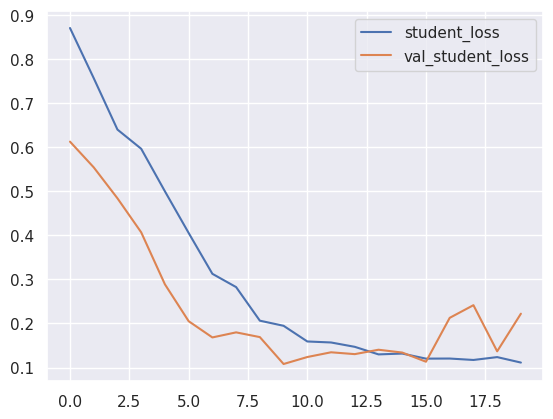

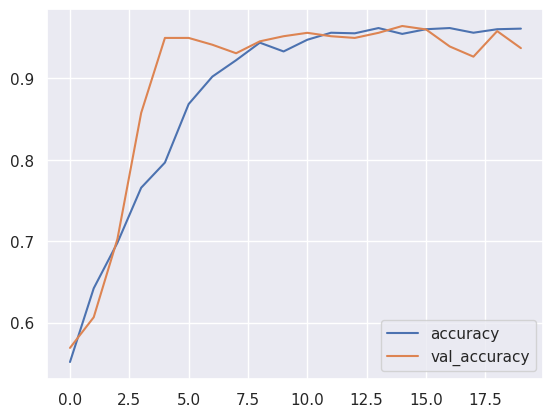

In [ ]:
distiller_history = pd.DataFrame(deit_history.history)
distiller_history.loc[:, ['student_loss', 'val_student_loss']].plot()
distiller_history.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print('Accuracy for Train: {:.4f}'.format(distiller_history['accuracy'].mean()))
print('Loss for Train: {:.4f}'.format(distiller_history['student_loss'].mean()))
print('Accuracy for Test: {:.4f}'.format(distiller_history['val_accuracy'].mean()))
print('Loss for Test: {:.4f}'.format(distiller_history['val_student_loss'].mean()))

Accuracy for Train: 0.8801
Loss for Train: 0.3042
Accuracy for Test: 0.8953
Loss for Test: 0.2384


In [ ]:
start_dist_deit = time.time()
predict_labels_dist_deit = deit_.predict(true_images)
duration_dist_deit = time.time() - start_dist_deit

loss_object = SparseCategoricalCrossentropy(from_logits=True)
true_labels_dist_deit = tf.reshape(true_labels, (-1,))
loss = loss_object(true_labels_dist_deit,predict_labels_dist_deit)

predict_labels_distiller = np.argmax(deit_.predict(true_images), axis=1)

print("Accuracy: {:0.4f}".format(accuracy_score(true_labels, predict_labels_distiller)))
print("Loss: {:0.4f}".format(loss))
print("Inference Time: {:.2f}s".format(duration_dist_deit))
print("Precision: {:0.4f}".format(precision_score(true_labels, predict_labels_distiller)))
print("Recall: {:0.4f}".format(recall_score(true_labels, predict_labels_distiller)))
print("F1-Score: {:0.4f}".format(f1_score(true_labels, predict_labels_distiller)))
print("AUC: {:0.4f}".format(roc_auc_score(true_labels, predict_labels_distiller)))
print("MCC: {:0.4f}".format(matthews_corrcoef(true_labels, predict_labels_distiller)))

Accuracy: 0.9531
Loss: 0.1419
Inference Time: 0.92s
Precision: 1.0000
Recall: 0.8765
F1-Score: 0.9342
AUC: 0.9383
MCC: 0.9027


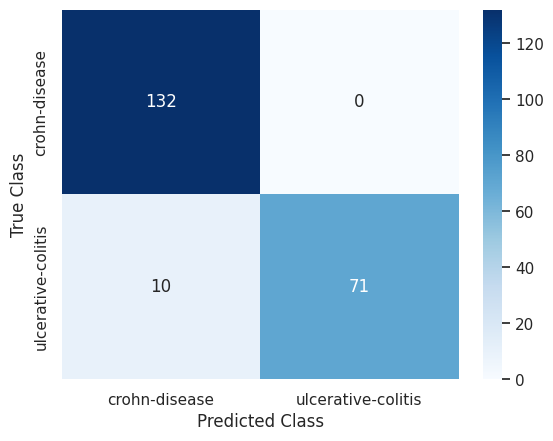

In [ ]:
conf_matrix_distiller = pd.DataFrame(confusion_matrix(true_labels, predict_labels_distiller), columns=['crohn-disease', 'ulcerative-colitis'], index=['crohn-disease', 'ulcerative-colitis'])
ax = sns.heatmap(conf_matrix_distiller, annot=True, fmt='', cmap='Blues')
ax.set(xlabel='Predicted Class', ylabel='True Class')
plt.show()

In [ ]:
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  preds_dist_2 = deit_.predict(img_array)
  if np.argmax(preds_dist_2, axis=1) == 0: print('crohn-disease')
  else: print('ulcerative-colitis')

ulcerative-colitis
crohn-disease
crohn-disease
crohn-disease
crohn-disease
crohn-disease


<h1>Interpretability of Teacher</h1>

<h3>Grad-Cam</h3>

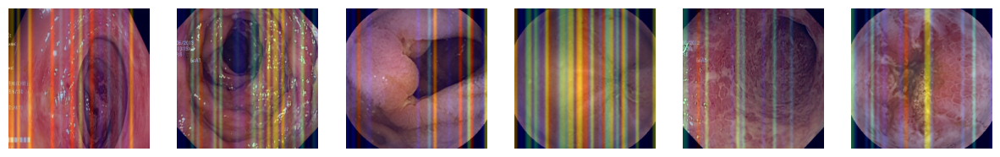

In [ ]:
last_conv_layer_name = "norm"

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  model_vit_hybrid_s32.layers[-1].activation = None

  preds = model_vit_hybrid_s32.predict(img_array)
  heatmap_cam = make_gradcam_heatmap_ViT(img_array, model_vit_hybrid_s32, last_conv_layer_name)

  heatmap_cam = np.reshape(heatmap_cam, (-1,50))
  display_gradcam(_images, heatmap_cam, preds=preds[0], plot=ax)

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

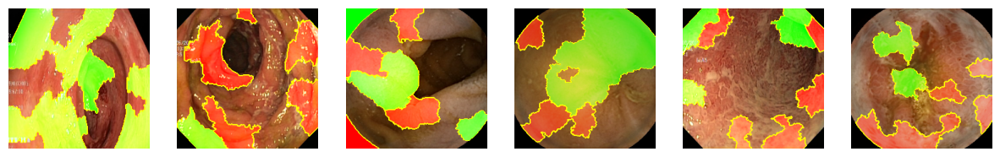

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), model_vit_hybrid_s32.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>Shapley Values</h3>

`tf.keras.backend.set_learning_phase` is deprecated and will be removed after 2020-10-11. To update it, simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


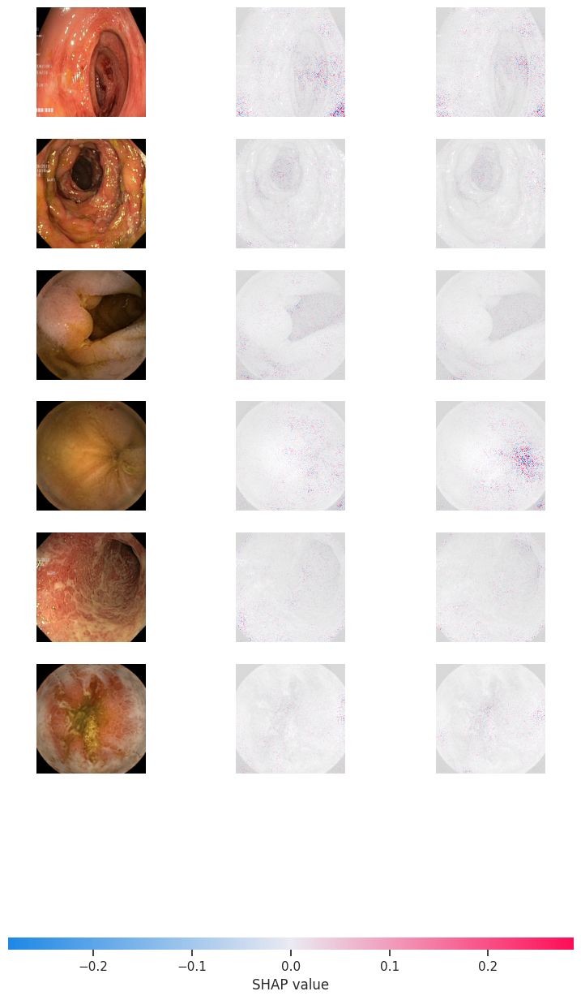

In [ ]:
images_train, labels_train = tuple(zip(*train_ds))
images_train_1 = np.concatenate(images_train)

shap_values = shap.GradientExplainer(model_vit_hybrid_s32, images_train_1).shap_values(image_interpretability_4)
shap.image_plot(shap_values, image_interpretability_4)

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, model_vit_hybrid_s32, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 452.53it/s]


Explaining: 100%|██████████| 32/32 [00:07<00:00,  4.25it/s]


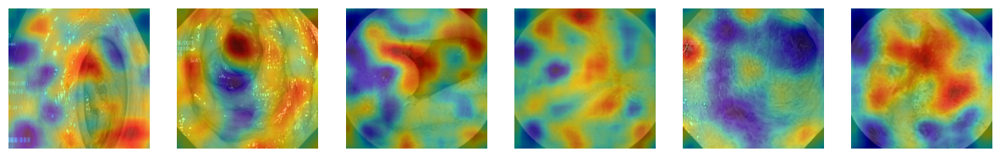

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

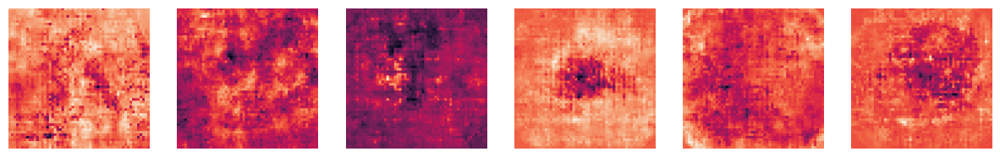

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap_occ = occ.get_heatmap(model_vit_hybrid_s32, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap_occ)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the First Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

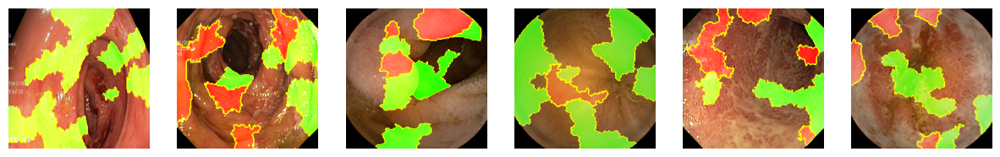

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), deit_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, deit_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 426.43it/s]


Explaining: 100%|██████████| 32/32 [00:02<00:00, 14.85it/s]


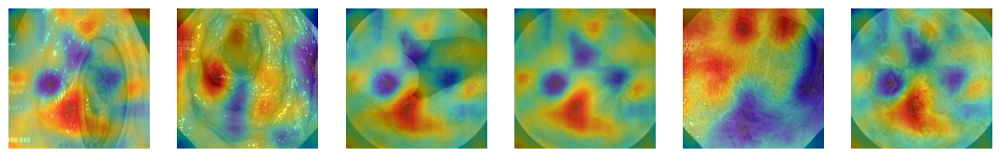

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

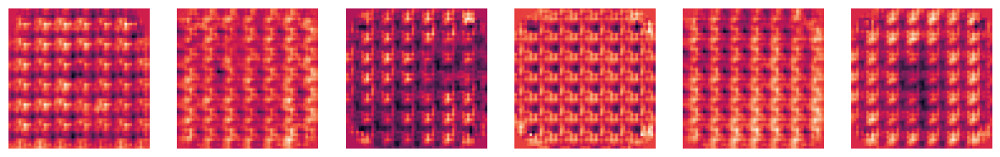

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(deit_, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1

<h1>Interpretability of the Second Student</h1>

<h3>LIME</h3>

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

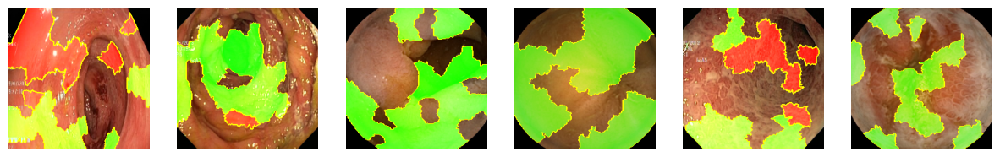

In [ ]:
explainer = lime_image.LimeImageExplainer()

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)
    
  explanation = explainer.explain_instance(img_array[0].astype(np.uint8), distillation_.predict, hide_color=0, num_samples=1000)
  temp_, mask_ = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=False, num_features=10, hide_rest=False)

  ax.imshow(mark_boundaries(temp_, mask_))
  ax.axis('off')

<h3>RISE (Randomized Image Sampling for Explanations)</h3>

In [ ]:
model_rise = RISE(1000, 8, 0.5, distillation_, batch_size,IMG_SIZE)
masks = model_rise.generate_masks()

Generating masks: 100%|██████████| 1000/1000 [00:02<00:00, 461.35it/s]


Explaining: 100%|██████████| 32/32 [00:01<00:00, 17.18it/s]


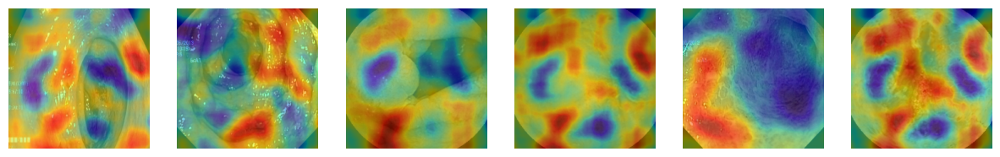

In [ ]:
idx = 0
fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  img_array = read_and_transform_img(_images)

  sal = model_rise.explain(img_array, masks)

  ax.imshow(_images.astype(np.uint8))
  ax.imshow(sal[int(labels_interpretability_4[idx])], cmap='jet', alpha=0.5)
  ax.axis('off')

  idx += 1

<h3>Occlusion Sensitivity</h3>

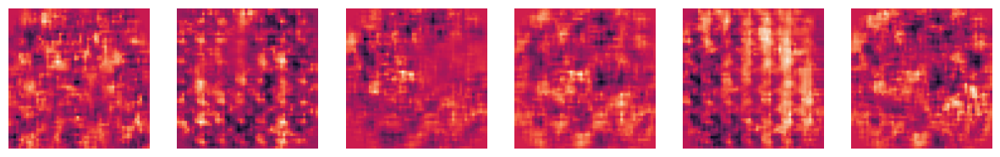

In [ ]:
idx = 0

fig, axis = plt.subplots(1, 6, figsize=(15, 15))
for _images, ax in zip(image_interpretability_4, axis.flat):
  occ = OcclusionMaps(_images)
  heatmap = occ.get_heatmap(distillation_, 4, int(labels_interpretability_4[idx]), IMG_SIZE[0])

  ax.imshow(heatmap)
  ax.axis('off')

  idx += 1